# Causing the Quakes: Computational Notebook
## Seismicity and Recent Trends in Induced Earthquakes

## 3. Analysis

### 3.1. RFM Modelling of Earthquake Risk 

Recency, Frequency, Monetary (RFM) Modelling is a modelling technique widely used in the marketing industry. The main aim of the model is to segment a customer base into different categories based on their spending habits and potential customer value. Each customer has a recency value (how long ago they last purchased from the company), a frequency value (how many times they have purchased from the company) and a monetary value (how much they have spent). By clustering customers based on these metrics, a company is able to separate customer groups. For example, customers with high monetary and frequency scores could be seen as 'high value, loyal' customers, whereas those with low monetary and recency scores could be seen as 'low-value lost' customers.

Research question 1 aims to see if this type of modelling could be applied to seismic data, to see how versatile this modelling technique is when applied to a different domain, and if it could be used to model earthquake risk effectively. The objective is to segment counties in the USA using earthquake recency, frequency and cumulative magnitude for risk modelling.

### 3.1.1. Data Preparation

###### 3.1.1.1. Module Initialisation

The necessary modules and settings needed throughout the project were initialised.

In [1]:
import os #for working directory
import csv #for handling csv data
import pandas as pd #for data manipulation and processing
import numpy as np #for mathematical operations
import datetime as dt #for dealing with temporal features
import seaborn as sns #for visual exploratory analysis
from shapely.geometry import Point #for spatial and geometric operations
import geopandas as gpd #for manipulation and processing of spatial data
import matplotlib.pyplot as plt #for data visualisation
import time #for dealing with temporal data
import plotly
import folium
from folium import plugins
pd.set_option('display.max_columns', None) #displays all columns in dataframs

Some modules specific to plotly are required to run this too. These are shown below.

In [2]:
#plotly specifics
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
plotly.tools.set_credentials_file(username='rhurley46', api_key='qnAm0NMkkIMnNr1w26H4')
import warnings
warnings.filterwarnings('ignore')

###### 3.1.1.2 Earthquake Data Wrangling and Preprocessing

Next, the working directory was set to the location of the downloaded data.

In [3]:
#change working directory
os.chdir(r'C:\Users\aczd067\OD\INM430-PriciplesOfDataScience\Fracking\Data\2.5+')

In [4]:
#create list of files in dirctory
files = os.listdir(r'C:\Users\aczd067\OD\INM430-PriciplesOfDataScience\Fracking\Data\2.5+')
for name in files:
    print(name)

2.5_1974-1981.csv
2.5_1981-1987.csv
2.5_1987-1993.csv
2.5_1993-2000.csv
2.5_2000-2008.csv
2.5_2008-2013.csv
2.5_2013-2016.csv
2.5_2016-2018.csv


The 8 files contain information about individual seismic events over 2.5m in the USA from 1974 to November 2018. The data was combined into a single dataframe.

In [5]:
#read each earthquake csv into dataframes
df1 = pd.read_csv(files[0], parse_dates=['time'], engine = 'python')
df2 = pd.read_csv(files[1], parse_dates=['time'], engine = 'python')
df3 = pd.read_csv(files[2], parse_dates=['time'], engine = 'python')
df4 = pd.read_csv(files[3], parse_dates=['time'], engine = 'python')
df5 = pd.read_csv(files[4], parse_dates=['time'], engine = 'python')
df6 = pd.read_csv(files[5], parse_dates=['time'], engine = 'python')
df7 = pd.read_csv(files[6], parse_dates=['time'], engine = 'python')
df8 = pd.read_csv(files[7], parse_dates=['time'], engine = 'python')

#create list of dataframes
alldfs = [df1, df2, df3, df4, df5, df6, df7, df8]

#concatenate individual dataframes into one
df = pd.concat(alldfs)

Overall data summaries are shown below, and then the first 5 observations.

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116950 entries, 0 to 9279
Data columns (total 22 columns):
time               116950 non-null datetime64[ns]
latitude           116950 non-null float64
longitude          116950 non-null float64
depth              116949 non-null float64
mag                116950 non-null float64
magType            116861 non-null object
nst                100155 non-null float64
gap                110909 non-null float64
dmin               73547 non-null float64
rms                112966 non-null float64
net                116950 non-null object
id                 116950 non-null object
updated            116950 non-null object
place              116950 non-null object
type               116950 non-null object
horizontalError    77603 non-null float64
depthError         98440 non-null float64
magError           61803 non-null float64
magNst             101174 non-null float64
status             116950 non-null object
locationSource     116950 non-null 

In [7]:
df.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst
count,116950.000000,116950.000000,116949.000000,116950.000000,100155.000000,110909.000000,73547.000000,112966.000000,77603.000000,98440.000000,61803.000000,101174.000000
mean,36.943207,-115.571127,6.413251,2.950836,23.930598,119.620287,0.224945,0.263483,1.690917,4.800972,0.166475,36.626268
std,4.057965,8.415045,6.093063,0.462772,28.212606,84.167130,0.316805,0.604138,6.899518,10.184923,0.115878,48.083119
min,24.602000,-124.999667,-3.480000,2.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,34.055000,-120.728750,2.822000,2.610000,0.000000,54.000000,0.039060,0.090000,0.230000,0.400000,0.100000,6.000000
50%,36.410583,-117.584000,5.475000,2.800000,16.000000,87.900000,0.094880,0.180000,0.509000,0.870000,0.147000,18.000000
75%,38.803333,-115.388125,8.422000,3.120000,35.000000,180.000000,0.279000,0.306000,1.400000,3.200000,0.208000,51.000000
max,49.988000,-65.065000,121.037000,7.300000,760.000000,360.000000,7.538000,69.320000,99.000000,374.500000,2.180000,438.000000


In [8]:
df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,id,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,1980-11-29 23:42:17.830,39.239833,-120.540833,11.511,2.70,md,17.0,268.0,0.2811,0.09,nc,nc1057640,2016-12-14T03:53:46.235Z,Northern California,earthquake,0.78,1.62,0.11,7.0,reviewed,nc,nc
1,1980-11-29 23:06:28.100,39.266000,-120.457333,11.476,2.93,md,31.0,101.0,0.1721,0.11,nc,nc1057639,2016-12-14T03:53:41.110Z,Northern California,earthquake,0.32,1.09,0.21,7.0,reviewed,nc,nc
2,1980-11-29 21:58:46.940,41.547667,-124.846667,4.996,2.79,md,12.0,337.0,0.9396,0.19,nc,nc1057637,2016-12-14T03:53:28.974Z,offshore Northern California,earthquake,16.65,17.29,0.03,5.0,reviewed,nc,nc
3,1980-11-29 21:05:18.760,41.400667,-124.753833,4.731,2.60,md,13.0,331.0,0.7802,0.17,nc,nc1057635,2016-12-14T03:53:21.657Z,offshore Northern California,earthquake,14.82,16.35,0.10,5.0,reviewed,nc,nc
4,1980-11-29 18:09:28.020,39.256167,-120.474167,14.881,2.52,md,20.0,250.0,0.3306,0.11,nc,nc1057633,2016-12-14T03:53:14.464Z,Northern California,earthquake,0.81,2.01,0.23,6.0,reviewed,nc,nc


From the summary, there are 116950 observations, each an individual earthquake. The data is mostly complete, although some features are missing lots of data. For example, 'dmin' with only 73,547 records, as well as 'horizontalError', 'depthError' and 'magError', which are missing a lot of data points too. This will need to be considered and dealt with appropriately during analysis. 

In terms of outliers, at this stage there are some indications of outliers in the data. This can be seen in instances, for example, where the mean of 'horizontalError' is 1.690917, and the max is 99.000000. This too indicates that there are outliers in the data that will need to be dealt with appropriately.

##### 3.1.1.3 Data Cleaning
We can remove some features as that are not relevant. However, we must first understand what each column means. This metadata is taken from the US Geological Survey website.

**'time'** - The time (UTC) the earthquake occurred.

**'latitude'** - Decimal latitude of the eathquake.

**'longitude'** - Decimal longitude of the earthquake.

**'depth'** - The depth of the earthquake below Earth surface.

**'mag'** - The magnitude of the earthquake on the richter scale.

**'magType'** - The method or algorithm used to calculate the preferred magnitude for the event.

**'nst'** - The total number of seismic stations used to determine earthquake location.

**'gap'** - The largest azimuthal gap between azimuthally adjacent stations (in degrees). In general, the smaller this number, the more reliable is the calculated horizontal position of the earthquake. Earthquake locations in which the azimuthal gap exceeds 180 degrees typically have large location and depth uncertainties.

**'dmin'** - Horizontal distance from the epicenter to the nearest station (in degrees). 1 degree is approximately 111.2 kilometers. In general, the smaller this number, the more reliable is the calculated depth of the earthquake.

**'rms'** - This parameter provides a measure of the fit of the observed arrival times to the predicted arrival times for this location. Smaller numbers reflect a better fit of the data.

**'net'** - The ID of a data contributor. Identifies the network considered to be the preferred source of information for this event.

**id** - A unique identifier for the event.

**updated** - Time when the event was most recently updated.

**place** - Textual description of named geographic region near to the event. This may be a city name, or a Flinn-Engdahl Region name.

**type** - Type of seismic event. eg. “earthquake”, “quarry”.

**horizontalError** - Uncertainty of reported location of the event in kilometers.

**depthError** - Uncertainty of reported depth of the event in kilometers.

**magError** - Uncertainty of reported magnitude of the event. The estimated standard error of the magnitude. 

**magNst** - The total number of seismic stations used to calculate the magnitude for this earthquake.

**status** - Indicates whether the event has been reviewed by a human.

**locationSource** - The network that originally authored the reported location of this event.


**magSource** - Network that originally authored the reported magnitude for this event.

Columns that added no value to the analysis were removed. 

These were; 'magType', 'net', 'id', 'updated', 'locationSource', 'magSource'.

In [9]:
df2 = df
df2 = df2.drop(['magType', 'net', 'id', 'updated', 'locationSource', 'magSource'], axis=1)
print("Remaining column names: \n \n", df2.columns.values)

Remaining column names: 
 
 ['time' 'latitude' 'longitude' 'depth' 'mag' 'nst' 'gap' 'dmin' 'rms'
 'place' 'type' 'horizontalError' 'depthError' 'magError' 'magNst'
 'status']


Next, any events where 'type' is not 'earthquake' were removed. For example, mining explosions, sonic booms. Only the earthquakes that have been reviewed were kept.

In [10]:
print("Possible earthquake types: \n\n", df2['type'].unique())

df3 = df2[df2['type'] == 'earthquake']
df3 = df3[df3['status'] == 'reviewed']

print("\n Remaing observations after removal: ", len(df3))

Possible earthquake types: 

 ['earthquake' 'quarry blast' 'nuclear explosion' 'explosion' 'other event'
 'mine collapse' 'chemical explosion' 'rock burst' 'sonic boom'
 'Rock Slide' 'mining explosion' 'acoustic noise' 'landslide'
 'experimental explosion']

 Remaing observations after removal:  110054


Outliers in the data were then removed. 

It is important to consider that sometimes, and in this project, outliers may be what we are looking for. However, they often can indicate poor quality data.

To ensure that the earthquake data is credible, any outliers in the measurement error columns were deleted, which indicated poor quality data.

Some measurements were missing, so the missing values were imputed with the median. The median was chosen instead of the mean in this case because outliers which are yet to be removed may affect the mean.

In [11]:
#impute median to measurement error columns
df4 = df3.fillna(df3.median())

After dealing with missing data, any outliers over 2 standard deviation from the mean from the measurement columns were removed.

In [12]:
#otlier removal 3std
#remove any measurement errors that are over +3 standard deviations
df5 = df4[df4['horizontalError']-df4['horizontalError'].mean() < (2*df4['horizontalError'].std())]
df5 = df4[df4['depthError']-df4['depthError'].mean() < (2*df4['depthError'].std())]
df5 = df4[df4['magError']-df4['magError'].mean() < (2*df4['magError'].std())]

print("\n Remaing observations after outlier removal: ", len(df5))


 Remaing observations after outlier removal:  105894


Deletion of redundant data, filtering of earthquake type, imputation of missing values and removal of erroneous measurement through outlier detection had been carried out. 

The earthquake dataset was the usable and credible.

The timescale of the data is shown below.

In [13]:
#convert 'time' to datetime format
df5['time'] = pd.to_datetime(df5['time'])
#format datetime
df5['time'] = pd.to_datetime(df5['time'], format= '%Y:%m:%d %H:%M:%S')

#print first date
print("First Earthquake: ", df5['time'].min())
#print last data
print("Last Earthquake: ", df5['time'].max())

First Earthquake:  1974-11-30 01:33:21.440000
Last Earthquake:  2018-11-01 06:37:14.430000


The data was from 30th November 1975 until 1st November 2018. This was trimmed down so there are only earthquakes from the start of 1975 to the end of 2017.

In [14]:
#trim date range of data
quakes = df5[(df5['time'].dt.year >= 1975) & (df5['time'].dt.year <= 2017)]
#order dataframe by time
quakes = quakes.sort_values(by='time', ascending=True)

print("First Earthquake: ", quakes['time'].min())
print("Last Earthquake: ", quakes['time'].max())
print("\n Number of observations: ", len(quakes))

First Earthquake:  1975-01-01 00:21:40.630000
Last Earthquake:  2017-12-31 19:49:06.270000

 Number of observations:  104130


##### 3.1.1.4. Data Derivation

After this, there was a trimmed, ordered dataframe containing 104,130 recorded earthquakes between 1975 and 2017, inclusive.

The dataframe was converted to a spatial dataframe which was needed for conversion to geodataframe and subsequent spatial queries and joins. A new column, 'coordinates' was derived from existing 'latitude' and 'longitude' columns.

In [15]:
#create coodinates column from lat long columns
quakes['coordinates'] = list(zip(quakes.longitude, quakes.latitude))

These were used as geometry for spatial operations after applying shapely's 'Point' method.

In [16]:
#convert coordinate to spatial point geometry
quakes['coordinates'] = quakes['coordinates'].apply(Point)

The dataframe was transformed into a spatial dataframe with geopandas.

In [17]:
#define geodataframe
quakes_gdf = gpd.GeoDataFrame(quakes, geometry = 'coordinates')
#set projection system
quakes_gdf.crs = {'init':'epsg:4326'}

This was then a spatial dataframe of the earthquake data, meaning that the data was able to be plotted on maps and have spatial operations performed on it.

The earthquake data was a rich dataset. However, one thing that it did lack was more detail about the location of the earthquakes. Despite latitude and longitude being present, the 'place' feature was vague at times, and not consistent enough for analysis. It would be ideal to have the name of the US state and state county of each earthquake.

These features were derived another way. This was done through a 'spatial join'. External shapefiles were be imported, and a spatial join was carried out on the existing 'quakes_gdf' data, and the shapefile to extract the required information.

In [18]:
#change working directory
os.chdir(r'C:\Users\aczd067\OD\INM430-PriciplesOfDataScience\Fracking\Data\Geospatial\USA_shps')

#load in counties shapefile
usa_counties_shp = gpd.read_file('gz_2010_us_050_00_5m.shp')
#set coordinate system
usa_counties_shp.crs = {'init':'epsg:4326'}

#load in states shapefile
usa_states_shp = gpd.read_file('cb_2017_us_state_5m.shp')
#set coordinate system
usa_states_shp.crs = {'init':'epsg:4326'}

Each county could be uniquely identified by concatenating the 'STATE' and 'COUNTY' codes.

In [19]:
#create unique county id
usa_counties_shp['county_id'] = usa_counties_shp['STATE'] + usa_counties_shp['COUNTY']
#view counties geodataframe
usa_counties_shp.head()

,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,county_id
0,0500000US02261,02,261,Valdez-Cordova,CA,34239.880,(POLYGON ((-147.483828196076 60.61863639871739...,02261
1,0500000US02270,02,270,Wade Hampton,CA,17081.433,"POLYGON ((-162.587753812495 63.2757266693285, ...",02270
2,0500000US02275,02,275,Wrangell,Cty&Bor,2541.483,"(POLYGON ((-132.569885212908 56.6335023081147,...",02275
3,0500000US02290,02,290,Yukon-Koyukuk,CA,145504.789,"POLYGON ((-141.00246494156 65.83942100063071, ...",02290
4,0500000US04003,04,003,Cochise,County,6165.690,"POLYGON ((-109.047612 32.426377, -109.048286 3...",04003


In [20]:
#view states geodataframe
usa_states_shp.head()

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry
0,01,01779775,0400000US01,01,AL,Alabama,00,131174431216,4592944701,"(POLYGON ((-88.04374299999999 30.517423, -88.0..."
1,02,01785533,0400000US02,02,AK,Alaska,00,1478588231566,277723861311,"(POLYGON ((-150.242099 61.137835, -150.228774 ..."
2,04,01779777,0400000US04,04,AZ,Arizona,00,294198661567,1027245114,"POLYGON ((-114.799683 32.593621, -114.809393 3..."
3,08,01779779,0400000US08,08,CO,Colorado,00,268425964573,1178495763,"POLYGON ((-109.060253 38.599328, -109.059541 3..."
4,12,00294478,0400000US12,12,FL,Florida,00,138911437206,31398800291,"(POLYGON ((-80.751643 24.857254, -80.729063 24..."


Geopandas spatial join was used function to join 'quakes_gdf' and 'usa_counties_shp' where they intersect, and then repetat with 'usa_states_shp'.

In [21]:
#join earthquake to county shapefile
quakes_sj = gpd.sjoin(quakes_gdf, usa_counties_shp, how = 'inner', op='within')
#drop unnecessary columns that were added
quakes_sj.drop(['index_right', 'GEO_ID', 'LSAD', 'CENSUSAREA'], axis = 1, inplace = True)

In [22]:
#join again to states shapefile
quakes_sj = gpd.sjoin(quakes_sj, usa_states_shp, how = 'inner', op='intersects')
#drop unnecessary columns that were added
quakes_sj.drop(['STATEFP', 'STATENS', 'AFFGEOID', 'GEOID','LSAD', 'ALAND', 'AWATER', 'index_right', 'COUNTY'], axis = 1, inplace = True)

In [23]:
print("\n Remaing observations after spatial join removal: ", len(quakes_sj))


 Remaing observations after spatial join removal:  82584


The number of observations were reduced. This was likely due to earthquakes appearing in Canada, Mexixo, or at sea.

Finally, some of the columns were renamed to make use more intuitive.

In [24]:
quakes_sj = quakes_sj.rename(columns={"STATE": "state_no", 
                                     "NAME_left": "county", 
                                     "STUSPS": "state_abb", 
                                     "NAME_right":"state"})
quakes_sj = quakes_sj.sort_values(by='time', ascending=True)

Regional information was still missing which may be helpful. The USA is vaguely split into 5 geographic areas; West, Southwest, Midwest, Southeast and Northeast. Using data from https://www.ducksters.com/geography/us_states/us_geographical_regions.php, these were made into a dictionary and mapped to a new column; 'region'.

In [25]:
#state dictionary (https://www.ducksters.com/geography/us_states/us_geographical_regions.php)
statedic = {'California':'West','Washington':'West','Arkansas':'Southeast','Missouri':'Midwest','Montana':'West',
            'Colorado':'West', 'Nevada':'West','Kentucky':'Southeast','Ohio':'Midwest','Alabama':'Southeast',
            'Wyoming':'West','Idaho':'West','Utah':'West','Arizona':'Southwest','Tennessee':'Southeast',
            'Oregon':'West','Nebraska':'Midwest','New York':'Northeast','Minnesota':'Midwest','Texas':'Southwest',
            'Mississippi':'Southeast','Oklahoma':'Southwest','Virginia':'Southeast','South Carolina':'Southeast',
            'New Mexico':'Southwest','West Virginia':'Southeast','Rhode Island':'Northeast','Massachusetts':'Northeast',
            'New Jersey':'Northeast','Georgia':'Southeast','Illinois':'Midwest','New Hampshire':'Northeast',
            'Maine':'Northeast','North Carolina':'Southeast','Maryland':'Northeast', 'Pennsylvania':'Northeast',
            'Vermont':'Northeast','Connecticut':'Northeast','Kansas':'Midwest','South Dakota':'Midwest',
            'North Dakota':'Midwest','Louisiana':'Southeast','Indiana':'Midwest','Michigan':'Midwest','Iowa':'Midwest',
            'Delaware':'Northeast'}

In [26]:
#map regions to quakes
quakes_sj['region'] = quakes_sj['state'].map(statedic)

In [27]:
quakes_sj.head()

,time,latitude,longitude,depth,mag,nst,gap,dmin,rms,place,type,horizontalError,depthError,magError,magNst,status,coordinates,state_no,county,county_id,state_abb,state,region
14284,1975-01-01 00:21:40.630,36.494667,-121.077000,5.141,3.39,24.0,67.0,0.01532,0.040,Central California,earthquake,0.26,0.540,0.30,9.0,reviewed,POINT (-121.077 36.4946667),06,San Benito,06069,CA,California,West
14283,1975-01-01 03:19:43.990,36.934833,-121.433000,5.121,2.78,23.0,72.0,0.05405,0.060,Central California,earthquake,0.19,0.650,0.13,8.0,reviewed,POINT (-121.433 36.9348333),06,San Benito,06069,CA,California,West
14282,1975-01-01 03:34:45.930,36.928500,-121.461167,5.636,2.56,21.0,62.0,0.04414,0.090,Central California,earthquake,0.27,0.660,0.25,4.0,reviewed,POINT (-121.4611667 36.9285),06,San Benito,06069,CA,California,West
14281,1975-01-01 06:52:39.820,36.929000,-121.460667,4.686,3.32,31.0,58.0,0.04505,0.100,Central California,earthquake,0.20,0.590,0.27,10.0,reviewed,POINT (-121.4606667 36.929),06,San Benito,06069,CA,California,West
14280,1975-01-01 07:51:38.790,34.230000,-117.446000,10.000,2.70,0.0,56.6,0.09369,0.309,"4km WNW of Devore, CA",earthquake,0.49,0.618,0.15,4.0,reviewed,POINT (-117.446 34.23),06,San Bernardino,06071,CA,California,West


This was them a preprocesed, spatially accurate point geodataframe, with derived features related to county and state location. The data was useable, credible and useful. Further analysis could then be performed.

#### 3.1.2. Earthquake RFM Modelling

For the RFM modelling and k-means clustering to be done, 'Recency', 'Frequency' and 'Magnitude' columns were derived for each county that had experienced an earthquake since 1975. 'Recency' was how many months ago the last earthquake occured. 'Frequency' was how many earthquakes had happened in this time, and 'Magnitude' was the cumulative magnitude since 1975 for each county.

##### 3.1.2.1. RFM Feature Derivation

In [28]:
#rfm table initialisation
quakes_rfm = quakes_sj[['time', 'county_id', 'county', 'state', 'mag']]
quakes_rfm.head()

,time,county_id,county,state,mag
14284,1975-01-01 00:21:40.630,06069,San Benito,California,3.39
14283,1975-01-01 03:19:43.990,06069,San Benito,California,2.78
14282,1975-01-01 03:34:45.930,06069,San Benito,California,2.56
14281,1975-01-01 06:52:39.820,06069,San Benito,California,3.32
14280,1975-01-01 07:51:38.790,06071,San Bernardino,California,2.70


To derive 'Recency', how many month ago the earthquake was.

In [29]:
enddate = dt.datetime(2018, 1, 1)
quakes_rfm['recency'] = quakes_rfm['time'].apply(lambda x: (enddate.year - x.year) * 12 + enddate.month - x.month)
quakes_rfm.head()

,time,county_id,county,state,mag,recency
14284,1975-01-01 00:21:40.630,06069,San Benito,California,3.39,516
14283,1975-01-01 03:19:43.990,06069,San Benito,California,2.78,516
14282,1975-01-01 03:34:45.930,06069,San Benito,California,2.56,516
14281,1975-01-01 06:52:39.820,06069,San Benito,California,3.32,516
14280,1975-01-01 07:51:38.790,06071,San Bernardino,California,2.70,516


Frequency was how many earthquakes had occured.

In [30]:
quakes_frequency = pd.DataFrame(quakes_rfm['county_id'].value_counts(), index = None)
quakes_frequency = quakes_frequency.reset_index(drop=False)
quakes_frequency.columns = ['county_id', 'frequency']
quakes_frequency.head()

,county_id,frequency
0,06071,9640
1,06051,6114
2,06025,4811
3,06069,3895
4,06065,3763


In [31]:
quakes_rfm2 = pd.merge(quakes_rfm, quakes_frequency, how = 'inner', on = 'county_id')
quakes_rfm2.head()

,time,county_id,county,state,mag,recency,frequency
0,1975-01-01 00:21:40.630,06069,San Benito,California,3.39,516,3895
1,1975-01-01 03:19:43.990,06069,San Benito,California,2.78,516,3895
2,1975-01-01 03:34:45.930,06069,San Benito,California,2.56,516,3895
3,1975-01-01 06:52:39.820,06069,San Benito,California,3.32,516,3895
4,1975-01-01 08:28:53.380,06069,San Benito,California,2.54,516,3895


Magnitude, was the cumulative magnitude since 1975.

In [32]:
quakes_rfm_table = quakes_rfm2.groupby('county_id').agg({'mag':'sum', 'recency':'min', 'frequency':'min'})
quakes_rfm_table = quakes_rfm_table.reset_index(drop=False)
quakes_rfm_table.head()

,county_id,mag,recency,frequency
0,01009,3.50,509,1
1,01019,2.58,7,1
2,01023,10.40,116,3
3,01025,6.30,154,2
4,01027,2.50,120,1


In [33]:
quakes_RFM = quakes_rfm_table.merge(quakes_rfm[['county_id', 'county', 'state']], on = 'county_id', how = 'right')
quakes_RFM = quakes_RFM.drop_duplicates(keep='first')
quakes_RFM = quakes_RFM.set_index('county_id')

In [34]:
quakes_RFM.head()

,mag,recency,frequency,county,state
county_id,,,,,
01009,3.50,509,1,Blount,Alabama
01019,2.58,7,1,Cherokee,Alabama
01023,10.40,116,3,Choctaw,Alabama
01025,6.30,154,2,Clarke,Alabama
01027,2.50,120,1,Clay,Alabama


##### 3.1.2.2. RFM Visualisation and Transformation

These metrics for each county could then be visualised on the plot below.

In [35]:
trace0 = Scatter3d(x=quakes_RFM.recency,
                   y=quakes_RFM.frequency,
                   z=quakes_RFM.mag,
                   mode='markers',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8),
                   text= (quakes_RFM['county']+", "+quakes_RFM['state'])
                  )

layout0 = Layout(title = 'Earthquake RFM Model',
                 scene = dict(xaxis = dict(title='Recency'),
                              yaxis = dict(title='Frequency'),
                              zaxis = dict(title='Magnitude'),
                              camera = dict( up=dict(x=0, y=0, z=1),
                                            center=dict(x=0, y=0, z=0),
                                            eye=dict(x=1.78, y=-1.84, z=0.34))),
                 margin=dict(r=0, l=0, b=0, t=40)
                )
data = [trace0]
fig4 = dict(data=data, layout=layout0)
iplot(fig4)

Clearly, the data was very skewed. This was because of the large variation between scales of the 3 metrics. To resolve this issue, the data was transformed using log normalisation and then visualised again.

In [36]:
#scale by log to standardise
quakes_RFM_log = quakes_RFM.applymap(lambda x: np.log(x) if isinstance(x, int) else (np.log(x) if isinstance(x, float) else x))
quakes_RFM_log.head()

,mag,recency,frequency,county,state
county_id,,,,,
01009,1.252763,6.232448,0.000000,Blount,Alabama
01019,0.947789,1.945910,0.000000,Cherokee,Alabama
01023,2.341806,4.753590,1.098612,Choctaw,Alabama
01025,1.840550,5.036953,0.693147,Clarke,Alabama
01027,0.916291,4.787492,0.000000,Clay,Alabama


In [37]:
trace0 = Scatter3d(x=quakes_RFM_log.recency,
                   y=quakes_RFM_log.frequency,
                   z=quakes_RFM_log.mag,
                   mode='markers',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8),
                   text= (quakes_RFM['county']+", "+quakes_RFM['state'])
                  )
layout0 = Layout(title = 'Earthquake RFM Model (Standardised)',
                 scene = dict(xaxis = dict(title='Recency'),
                              yaxis = dict(title='Frequency'),
                              zaxis = dict(title='Magnitude'),
                              camera = dict( up=dict(x=0, y=0, z=1),
                                            center=dict(x=0, y=0, z=0),
                                            eye=dict(x=1.78, y=-1.84, z=0.34))),
                 margin=dict(r=0, l=0, b=0, t=40)
                )
data = [trace0]
fig5 = dict(data=data, layout=layout0)
iplot(fig5)

The result of this meant that there was a much clearer and despersed set of data points. K-means clustering was then able to be performed.

##### 3.1.2.3. RFM K-means Clustering

K-means clustering is an unsupervised learning algorithm used to partition a dataset into a defined number of groups. It was chosed to be used for this project as it would partition the US counties in the RFM model into different groups with similar recency, frequency and monetary characteristics, which would then be used to classify counties according to seismic event risk.

The k-means algorithm  was initialised with 'k-means ++' selected as a hyperparameter. This selects initial cluster centers for k-mean clustering in an optimised way to speed up convergence.

The model was run 15 times. Each time the within cluser sum of squares (WCSS) metric was calculated. The aim was to minimised this whilts using an optimim number of clusters. The elbow method was used to select the number of clusters following this.

In [38]:
#kmeans clustering
from sklearn.cluster import KMeans
#elbow graph
wcss = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters= i, init = 'k-means++', random_state=42)
    kmeans.fit(quakes_RFM_log.iloc[:, 0:2])
    wcss.append(kmeans.inertia_)

In [39]:
#plot WCSS elbow graph
trace0 = Scatter(x = np.array(range(1,15)), y = wcss, mode = "lines", name = "WCSS",
                 marker = dict(color = 'rgba(0, 0, 255, 1)'), text= wcss)

data = [trace0]

layout = dict(title = 'Elbow Graph',    
              xaxis= dict(title= 'Number of Clusters', 
                          ticklen= 5,
                          zeroline= True),
              yaxis = dict(title= 'WCSS'),
              annotations=[dict(x=4, y=1319,
                                xref='x', yref='y', text='WCSS Plateau',
                                showarrow=True, arrowhead=7, ax=0, ay=-240)])

fig6 = dict(data = data, layout = layout)
iplot(fig6)

The elbow method indicates that the optimum number of cluseters is around 4. The kmeans algorithm was run again with this as the number of clusters. The cluste information was then assessed.

In [40]:
kmeans = KMeans(n_clusters= 4, init = 'k-means++', random_state=42)
clusters  = kmeans.fit_predict(quakes_RFM_log.iloc[:, 0:2])
quakes_RFM_log['cluster'] = clusters

In [41]:
RFM_cluster0 = quakes_RFM_log[quakes_RFM_log['cluster'] == 0]
RFM_cluster1 = quakes_RFM_log[quakes_RFM_log['cluster'] == 1]
RFM_cluster2 = quakes_RFM_log[quakes_RFM_log['cluster'] == 2]
RFM_cluster3 = quakes_RFM_log[quakes_RFM_log['cluster'] == 3]

In [42]:
cluster_groups = [RFM_cluster0, RFM_cluster1, RFM_cluster2, RFM_cluster3]
for cluster in cluster_groups:
    print("Cluster: ",cluster.cluster.min())
    print(cluster.describe())
    print(" ")

Cluster:  0
              mag     recency   frequency  cluster
count  218.000000  218.000000  218.000000    218.0
mean     1.972899    2.769788    0.914534      0.0
std      0.701142    1.103416    0.692325      0.0
min      0.916291    0.000000    0.000000      0.0
25%      1.259806    1.945910    0.000000      0.0
50%      1.965913    3.178054    0.895880      0.0
75%      2.540418    3.637586    1.386294      0.0
max      3.427515    4.158883    2.397895      0.0
 
Cluster:  1
              mag     recency   frequency  cluster
count  110.000000  110.000000  110.000000    110.0
mean     6.635029    0.660773    5.554449      1.0
std      1.356160    0.802653    1.357642      0.0
min      4.139477    0.000000    2.995732      1.0
25%      5.516294    0.000000    4.403541      1.0
50%      6.473718    0.000000    5.402637      1.0
75%      7.538933    1.386294    6.462226      1.0
max     10.237519    3.044522    9.173676      1.0
 
Cluster:  2
              mag     recency   frequency 

We can see from the cluster metrics that 'Cluster 1' has the lowest average recency, but highest average frequency and magnitudes. The counties with in this cluster are likely the 'Very High Risk' counties.

'Cluster 3' has the highest average recency, and lowest mean frequency and magnitude scores. This indicated seismic activity usually last happened longer ago than in other counties, and very infrequently, perhaps just 'one-off' events. These are 'Low Risk' Counties.

Of the remaining two clusters, 'Cluster 0' has lower average magnitude and frequency, but lower recency to. These are counties that have had activity more recently in cases, but not very active in general- 'Moderate Risk'. For 'Cluster 2', although the average recency is slightly higher that of 'Cluster 3', it still has had higher average magnitude and frequency scores, showing more seismic activity. These are therefore 'High Risk' counties.

Counties were assigned these new labels.

In [43]:
#assign new label risk names
risk = {0:'Moderate Risk', 1: 'Very High Risk', 2:'High Risk', 3:'Low Risk'}
#map new names to dataframe
quakes_RFM_log['Risk Factor'] = quakes_RFM_log['cluster'].map(risk)

In [44]:
quakes_RFM_log.tail()

,mag,recency,frequency,county,state,cluster,Risk Factor
county_id,,,,,,,
56035,4.098669,2.833213,2.890372,Sublette,Wyoming,2,High Risk
56037,4.990705,1.386294,3.828641,Sweetwater,Wyoming,1,Very High Risk
56039,7.334427,1.386294,6.244167,Teton,Wyoming,1,Very High Risk
56041,3.054001,3.258097,2.079442,Uinta,Wyoming,2,High Risk
56043,3.198673,0.693147,2.079442,Washakie,Wyoming,0,Moderate Risk


In [45]:
quakes_RFM_log.head()

,mag,recency,frequency,county,state,cluster,Risk Factor
county_id,,,,,,,
01009,1.252763,6.232448,0.000000,Blount,Alabama,3,Low Risk
01019,0.947789,1.945910,0.000000,Cherokee,Alabama,0,Moderate Risk
01023,2.341806,4.753590,1.098612,Choctaw,Alabama,3,Low Risk
01025,1.840550,5.036953,0.693147,Clarke,Alabama,3,Low Risk
01027,0.916291,4.787492,0.000000,Clay,Alabama,3,Low Risk


After assingning the clusters the new labels, the final results could agaom be visualised on a graph.

In [46]:
RFM_cluster_VH = quakes_RFM_log[quakes_RFM_log['Risk Factor'] == 'Very High Risk']
RFM_cluster_H = quakes_RFM_log[quakes_RFM_log['Risk Factor'] == 'High Risk']
RFM_cluster_M = quakes_RFM_log[quakes_RFM_log['Risk Factor'] == 'Moderate Risk']
RFM_cluster_L = quakes_RFM_log[quakes_RFM_log['Risk Factor'] == 'Low Risk']

In [47]:
trace1 = Scatter3d(x=RFM_cluster_VH.recency,
                   y=RFM_cluster_VH.frequency,
                   z=RFM_cluster_VH.mag,
                   mode='markers',
                   name = 'Very High Risk',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8,
                               color = 'rgba(255, 0, 0, 0.6)'),
                   text= (RFM_cluster_VH['county']+", "+RFM_cluster_VH['state'])
                  )
trace2 = Scatter3d(x=RFM_cluster_H.recency,
                   y=RFM_cluster_H.frequency,
                   z=RFM_cluster_H.mag,
                   mode='markers',
                   name = 'High Risk',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8,
                               color = 'rgba(255, 128, 0, 0.6)'),
                   text= (RFM_cluster_H['county']+", "+RFM_cluster_H['state'])
                  )
trace3 = Scatter3d(x=RFM_cluster_M.recency,
                   y=RFM_cluster_M.frequency,
                   z=RFM_cluster_M.mag,
                   mode='markers',
                   name = 'Moderate Risk',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8,
                               color = 'rgba(204, 204, 0, 0.6)'),
                   text= (RFM_cluster_M['county']+", "+RFM_cluster_M['state'])
                  )
trace4 = Scatter3d(x=RFM_cluster_L.recency,
                   y=RFM_cluster_L.frequency,
                   z=RFM_cluster_L.mag,
                   mode='markers',
                   name = 'Low Risk',
                   marker=dict(size=4,                # set color to an array/list of desired values
                               colorscale='Viridis',   # choose a colorscale
                               opacity=0.8,
                               color = 'rgba(0, 128, 0, 0.6)'),
                   text= (RFM_cluster_L['county']+", "+RFM_cluster_L['state'])
                  )
layout0 = Layout(title = 'Earthquake RFM Model (Standardised)',
                 scene = dict(xaxis = dict(title='Recency'),
                              yaxis = dict(title='Frequency'),
                              zaxis = dict(title='Magnitude'),
                              camera = dict( up=dict(x=0, y=0, z=1),
                                            center=dict(x=0, y=0, z=0),
                                            eye=dict(x=1.78, y=-1.84, z=0.34))),
                 margin=dict(r=0, l=0, b=0, t=40)
                )
data = [trace1, trace2, trace3, trace4]
fig7 = dict(data=data, layout=layout0)
iplot(fig7)

The k-means clustering results of the earthquake RFM data can be seen in the figure above. We can very clearly see the differences between different risk categoried. Hovering over points on the graph allows information on the counties to be viewed. Lots of the Very High Risk counties are are around California and some other states.

Model evaluation and performance could then be carried out.

##### 3.1.2.4. Model Evaluation
To evaluate the model, earthquake data from the first ten months of 2018. Using the classification outputs from the k-means clustering, the propotion of earthquakes occuring in each of the risk classes was calulated.

It was decided that for the model to be seen as useful; 80% of 2018 earthquakes should occur in 'Very High Risk' counties, 10% should occur in 'High Risk' counties, and the rest should be evenly split between the other two categories.

The earthquakes in 2018 were isolated and previous spatial operations performed again.

In [48]:
#using initial quakes_sj
#trim date range of data
quakes18 = df5[(df5['time'].dt.year >= 2018) & (df5['time'].dt.month <= 10)]
#order dataframe by time
quakes18 = quakes18.sort_values(by='time', ascending=True)

#print first date
print("First Earthquake: ", quakes18['time'].min())
#print last data
print("Last Earthquake: ", quakes18['time'].max())

First Earthquake:  2018-01-01 01:35:34.240000
Last Earthquake:  2018-10-31 23:50:49.760000


In [49]:
quakes18['coordinates'] = list(zip(quakes18.longitude, quakes18.latitude))
#convert to spatial points
quakes18['coordinates'] = quakes18['coordinates'].apply(Point)
#define geodataframe
quakes18_gdf = gpd.GeoDataFrame(quakes18, geometry = 'coordinates')
#set projection system
quakes18_gdf.crs = {'init':'epsg:4326'}
#join earthquake to county shapefile
quakes18_sj = gpd.sjoin(quakes18_gdf, usa_counties_shp, how = 'inner', op='within')
#drop unnecessary columns that were added
quakes18_sj.drop(['index_right', 'GEO_ID', 'LSAD', 'CENSUSAREA'], axis = 1, inplace = True)

In [50]:
usa_counties_cluster = pd.merge(usa_counties_shp, quakes_RFM_log, left_on= 'county_id', right_index=True, how = 'inner')
#usa_counties_cluster.to_file('usa_counties_cluster_2.shp', driver='ESRI Shapefile')

The counties from the RMF model were separated into different dataframes.

In [51]:
usa_counties_cluster_HHR = usa_counties_cluster[usa_counties_cluster['Risk Factor'] == "Very High Risk"]
usa_counties_cluster_HR = usa_counties_cluster[usa_counties_cluster['Risk Factor'] == "High Risk"]
usa_counties_cluster_MR = usa_counties_cluster[usa_counties_cluster['Risk Factor'] == "Moderate Risk"]
usa_counties_cluster_LR = usa_counties_cluster[usa_counties_cluster['Risk Factor'] == "Low Risk"]

In [52]:
quakes18_sj_clusts = gpd.sjoin(quakes18_sj, usa_counties_cluster, how = 'inner', op='within')
quakes18_sj_clusts.head()

,time,latitude,longitude,depth,mag_left,nst,gap,dmin,rms,place,type,horizontalError,depthError,magError,magNst,status,coordinates,STATE_left,COUNTY_left,NAME_left,county_id_left,index_right,GEO_ID,STATE_right,COUNTY_right,NAME_right,LSAD,CENSUSAREA,county_id_right,mag_right,recency,frequency,county,state,cluster,Risk Factor
1839,2018-01-01 01:35:34.240,34.031667,-117.593000,4.08,3.09,173.0,15.0,0.07663,0.22,"4km SE of Ontario, CA",earthquake,0.09,0.34,0.175,330.0,reviewed,POINT (-117.593 34.0316667),06,071,San Bernardino,06071,77,0500000US06071,06,071,San Bernardino,County,20056.938,06071,10.237519,0.0,9.173676,San Bernardino,California,1,Very High Risk
1783,2018-01-10 14:05:41.110,34.007333,-117.180167,15.16,2.79,144.0,20.0,0.03653,0.17,"5km S of Redlands, CA",earthquake,0.09,0.17,0.133,185.0,reviewed,POINT (-117.1801667 34.0073333),06,071,San Bernardino,06071,77,0500000US06071,06,071,San Bernardino,County,20056.938,06071,10.237519,0.0,9.173676,San Bernardino,California,1,Very High Risk
1759,2018-01-14 19:56:11.650,34.816833,-116.073333,3.75,3.71,81.0,39.0,0.14830,0.18,"13km NE of Ludlow, CA",earthquake,0.11,0.54,0.150,4.0,reviewed,POINT (-116.0733333 34.8168333),06,071,San Bernardino,06071,77,0500000US06071,06,071,San Bernardino,County,20056.938,06071,10.237519,0.0,9.173676,San Bernardino,California,1,Very High Risk
1704,2018-01-22 14:54:00.980,34.702500,-116.231833,3.01,2.95,30.0,61.0,0.06911,0.16,"7km WSW of Ludlow, CA",earthquake,0.17,0.42,0.133,126.0,reviewed,POINT (-116.2318333 34.7025),06,071,San Bernardino,06071,77,0500000US06071,06,071,San Bernardino,County,20056.938,06071,10.237519,0.0,9.173676,San Bernardino,California,1,Very High Risk
1688,2018-01-24 19:30:13.650,34.277167,-117.521000,7.68,2.50,100.0,20.0,0.04302,0.19,"3km NW of Lytle Creek, CA",earthquake,0.12,0.31,0.154,141.0,reviewed,POINT (-117.521 34.2771667),06,071,San Bernardino,06071,77,0500000US06071,06,071,San Bernardino,County,20056.938,06071,10.237519,0.0,9.173676,San Bernardino,California,1,Very High Risk


The total number of earthquakes within the USA county boundaries are shown below.

In [53]:
#all earthquakes WITHIN usa county boundaries
quakes_sj_all = gpd.sjoin(quakes18_sj, usa_counties_shp, how = 'inner', op='within')
len(quakes_sj_all)

1422

Then, the number if these earthquakes occuring in each of the risk categories was calculated.

In [54]:
print("Total number of 2018 earthquakes: ", len(quakes_sj_all))
print("Number of 2018 earthquakes in 'Very High Risk' counties: ", quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Very High Risk'].time.count())
print("Number of 2018 earthquakes in 'High Risk' counties: ", quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'High Risk'].time.count())
print("Number of 2018 earthquakes in 'Moderate Risk' counties: ", quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Moderate Risk'].time.count())
print("Number of 2018 earthquakes in 'Low Risk' counties: ", quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Low Risk'].time.count())
print("Number of 2018 earthquakes in new counties: ", ((len(quakes_sj_all)) - (quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Very High Risk'].time.count()) - (quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'High Risk'].time.count()) - (quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Moderate Risk'].time.count()) - (quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Low Risk'].time.count())))

Total number of 2018 earthquakes:  1422
Number of 2018 earthquakes in 'Very High Risk' counties:  1206
Number of 2018 earthquakes in 'High Risk' counties:  112
Number of 2018 earthquakes in 'Moderate Risk' counties:  69
Number of 2018 earthquakes in 'Low Risk' counties:  20
Number of 2018 earthquakes in new counties:  15


The proportional breakdown can be viewed below.

In [55]:
fig31 = {"data": [{"values": [quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Very High Risk'].time.count(),
                              quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'High Risk'].time.count(),
                              quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Moderate Risk'].time.count(),
                              quakes18_sj_clusts[quakes18_sj_clusts['Risk Factor'] == 'Low Risk'].time.count(),
                              15],
                   "labels": ["Very High Risk", "High Risk", "Moderate Risk", "Low Risk","New Counties"],
                   "domain": {"x": [0, .48]},
                   "name": "2018 Earthquake RFM Model Assessment",
                   "hoverinfo":"label+percent+name",
                   "hole": .4,
                   "type": "pie",
                   'marker': {'colors': ['rgb(255, 0, 0)', 'rgb(255, 128, 0)', 'rgb(204, 204, 0)', 'rgb(0, 128, 0)','rgb(211,211,211)']},
                  }
                 ],
         "layout": {"title":"2018 Earthquake RFM Model Assessment",
                   }
        }
iplot(fig31)

These results show that the model performed well with regards to the evaluation requirements at the start of 2.1.2.4. It is shown that the model exceded expectations, as 84.8% of the earthquakes occured in 'Very High Risk' counties. The 'High Risk' county requirement was not met as this was 7.88% rater than 10% - however, this is attributable to the stronger than expected performance of the 'Very High Risk'. The remaining categories performed well as desired. 1.05% of earthquakes occurred in unclassified counties. This is a slight limitation in the model, and suggests that any counties that are not classifies after RFM clustering should be assigned to 'Low Risk' counties.

### 3.2. Earthquake Spatio-temporal Analysis

#### 3.2.1. Spatial Distribution of RFM Clustering

Following this analysis, it was deemed useful to assess the spatial distribution of these counties to see if this gave us any more information about spatial distribution of the RFM clustering.

A chloropleth map shows the location and 'Risk Factor' of each of the counties below.

In [56]:
n = folium.Map([39.039809, -95.493028 ], zoom_start=4, tiles='cartodbpositron')
folium.Choropleth(usa_counties_cluster_HHR, name = 'Very High Risk', fill_color='Red',line_color='Red',highlight=True).add_to(n)
folium.Choropleth(usa_counties_cluster_HR, name = 'High Risk', fill_color='Orange',line_color='Orange',highlight=True).add_to(n)
folium.Choropleth(usa_counties_cluster_MR, name = 'Moderate Risk', fill_color='Yellow',line_color='Yellow',highlight=True).add_to(n)
folium.Choropleth(usa_counties_cluster_LR, name = 'Low Risk', fill_color='Green',line_color='Green',highlight=True).add_to(n)
# add the layer control
folium.LayerControl(collapsed=False).add_to(n)
n

The map shows a few things. 'Very High Risk' counties are mostly around the West of the USA. Interestingly, there are small pockets of VHR counties around Oklahma and some near Tenessee and Arkansas. The VHR counties are generally near HR counties, with Moderate and Low risk counties dispersed more widely. 

Time series analysis was then carried out to investigate these patterns further.

#### 3.2.2. USA Seismic Time Series Analysis

A graph showing the annual number of earthquakes per year since 1975 was plotted.

In [57]:
#new dataframe for annual
annual_quakes = quakes_sj

#convert 'time' to datetime
annual_quakes['time'] = pd.to_datetime(annual_quakes['time'], errors='coerce', unit='s')
#set index to time for time series
annual_quakes = annual_quakes.set_index('time')

In [58]:
yearly_quakes = annual_quakes.resample('Y').count() 

In [59]:
#plot annual earthquakes
trace0 = Scatter(x = yearly_quakes.index,
                 y = yearly_quakes.latitude,
                 mode = "lines",
                 name = "earthquakes",
                 marker = dict(color = 'rgba(0, 0, 0, 1)'),
                 text= yearly_quakes.index.year)
data = [trace0]
layout = dict(title = 'USA Annual Earthquake Count (1975 - 2017)',
              xaxis= dict(title= 'Year', 
                          ticklen= 5,
                          zeroline= False),
              yaxis= dict(title= 'Earthquakes'),
              annotations=[dict(x=pd.to_datetime('1993-01-01 00:00:00.00'), y=6989,
                                xref='x', yref='y', text='California 1992 Earthquakes', 
                                showarrow=True, arrowhead=7, ax=150, ay=0)]
             )
fig0 = dict(data = data, layout = layout)
iplot(fig0)

It appears that the annual count of earthquakes across the USA is rather volatile and doesn't show much of a pattern or trend. There is a large peak in 1992. This is attributable to a spate of earthquakes in California that year. Recemy trends show that there has been a rise and quick fall since 2012.

However, the USA is a large country, and it would be interesting to see if these was consistent across all states.

In [60]:
quakes_ann_west = quakes_sj[quakes_sj['region'] == 'West'].set_index('time').resample('Y').count()
quakes_ann_midwest = quakes_sj[quakes_sj['region'] == 'Midwest'].set_index('time').resample('Y').count()
quakes_ann_northeast = quakes_sj[quakes_sj['region'] == 'Northeast'].set_index('time').resample('Y').count()
quakes_ann_southeast = quakes_sj[quakes_sj['region'] == 'Southeast'].set_index('time').resample('Y').count()
quakes_ann_southwest = quakes_sj[quakes_sj['region'] == 'Southwest'].set_index('time').resample('Y').count()

In [61]:
#plot annual earthquakes
trace0 = Scatter(x = yearly_quakes.index, y = yearly_quakes.latitude, mode = "lines", name = "USA Total",
                 marker = dict(color = 'rgba(0, 0, 0, 0.2)'), line = dict(dash = 'dash'), text= yearly_quakes.index.year)
trace1 = Scatter(x = quakes_ann_west.index,y = quakes_ann_west.latitude,mode = "lines",name = "West",
                 marker = dict(color = 'rgba(255, 0, 0, 1)'),text= quakes_ann_west.index.year)
trace2 = Scatter(x = quakes_ann_midwest.index,y = quakes_ann_midwest.latitude,mode = "lines",name = "Midwest",
                 marker = dict(color = 'rgba(0, 128, 0, 1)'), text= quakes_ann_midwest.index.year)
trace3 = Scatter(x = quakes_ann_northeast.index,y = quakes_ann_northeast.latitude, mode = "lines",name = "Northeast",
                 marker = dict(color = 'rgba(255, 128, 0, 1)'),text= quakes_ann_northeast.index.year)
trace4 = Scatter(x = quakes_ann_southeast.index,y = quakes_ann_southeast.latitude, mode = "lines",name = "Southeast",
                 marker = dict(color = 'rgba(0, 0, 225, 1)'),text= quakes_ann_southeast.index.year)
trace5 = Scatter(x = quakes_ann_southwest.index, y = quakes_ann_southwest.latitude, mode = "lines",name = "Southwest",
                 marker = dict(color = 'rgba(204, 204, 0, 1)'),text= quakes_ann_southwest.index.year)

data = [trace0, trace1, trace2, trace3, trace4, trace5]

layout = dict(title = 'USA Annual Earthquake Count by Region (1975 - 2017)',    
              xaxis= dict(title= 'Year', 
                          ticklen= 5,
                          zeroline= False),
              yaxis= dict(title= 'Earthquakes'),
              annotations=[dict(x=pd.to_datetime('2014-01-01 00:00:00.00'), y=330,
                       xref='x', yref='y', text='Sharp rise in<br>Southwest earthquakes',
                       showarrow=True, arrowhead=7, ax=0, ay=-240)]
             )
fig2 = dict(data = data, layout = layout)
iplot(fig2)

We can now clearly see that there is significant regional variation in the amount of earthquakes across the USA. It appears that the main driver of earthquake counts is the events in the West, as this mimics the pattern of the USA. However, what is interesting is that earthquakes in other regions change patterns after 2010, especially in the Southwest, where there is a sharp rise, to 2,880 earthquakes recently.

A closer look was taken to see what was going on in each state in the Southwest.

In [62]:
#isolate earthquakes in southwest only
quakes_sj_southwest = quakes_sj[quakes_sj['region'] == 'Southwest']
quakes_sj_southwest['state'].unique()

array(['Arizona', 'Texas', 'Oklahoma', 'New Mexico'], dtype=object)

In [63]:
quakes_ann_arizona = quakes_sj_southwest[quakes_sj_southwest['state'] == 'Arizona'].set_index('time').resample('Y').count()
quakes_ann_texas = quakes_sj_southwest[quakes_sj_southwest['state'] == 'Texas'].set_index('time').resample('Y').count()
quakes_ann_oklahoma = quakes_sj_southwest[quakes_sj_southwest['state'] == 'Oklahoma'].set_index('time').resample('Y').count()
quakes_ann_newmexico = quakes_sj_southwest[quakes_sj_southwest['state'] == 'New Mexico'].set_index('time').resample('Y').count()

In [64]:
#plot annual earthquakes
trace0 = Scatter(x = quakes_ann_arizona.index, y = quakes_ann_arizona.latitude,mode = "lines",name = "Arizona",
                 marker = dict(color = 'rgba(102, 255, 255, 0.4)'), text= quakes_ann_arizona.index.year)
trace1 = Scatter(x = quakes_ann_texas.index, y = quakes_ann_texas.latitude, mode = "lines", name = "Texas",
                 marker = dict(color = 'rgba(255, 0, 0, 1)'), text= quakes_ann_texas.index.year)
trace2 = Scatter(x = quakes_ann_oklahoma.index, y = quakes_ann_oklahoma.latitude, mode = "lines", name = "Oklahoma",
                 marker = dict(color = 'rgba(0, 128, 0, 1)'), text= quakes_ann_oklahoma.index.year)
trace3 = Scatter(x = quakes_ann_newmexico.index, y = quakes_ann_newmexico.latitude, mode = "lines", name = "New Mexico",
                 marker = dict(color = 'rgba(255, 128, 0, 1)'), text= quakes_ann_newmexico.index.year)

data = [trace0, trace1, trace2, trace3]

layout = dict(title = 'Southeast USA Annual Earthquake Count by State (1975 - 2017)',    
              xaxis= dict(title= 'Year', 
                          ticklen= 5,
                          zeroline= False))
fig3 = dict(data = data, layout = layout)
iplot(fig3)

It is clear from the figure above, that the main driver of earthquakes in the Southeast states is Oklahoma. This, is abnormal not only because Oklahoma is not near any major fault lines, but also because of the sharp rise in the amount of earthquakes since 2010.

#### 3.2.3. USA Seismic Spatio-Temporal Analysis

The spatio-temporal patterns are not best visualised using static graphs. The animations below show the patterns of earthquake activity from 1975 to 2017.

In [65]:
#Extract the month column from pickup datetime variable and take subset of data
quakes_sj['year'] = quakes_sj['time'].dt.year
heat_df = quakes_sj[['latitude', 'longitude','year']]
# Ensure you're handing it floats
heat_df['latitude'] = heat_df['latitude'].astype(float)
heat_df['longitude'] = heat_df['longitude'].astype(float)
heat_df
# Create weight column, using date
heat_df['Weight'] = heat_df['year']
heat_df['Weight'] = heat_df['Weight'].astype(float)
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude', 'Weight'])

In [66]:
quakes_on_heatmap  = folium.Map([39.039809, -95.493028 ], zoom_start=4, tiles='cartodbpositron')

# List comprehension to make out list of lists
heat_data = [[[row['latitude'],row['longitude']] 
              for index, row in heat_df[heat_df['Weight'] == i].iterrows()] 
                 for i in range(1975,2017)]
# Plot it on the map
hm = plugins.HeatMapWithTime(heat_data,auto_play=True, max_opacity=1, radius=5)
folium.CircleMarker(location=[36, -97.5],radius=35,fill=True,
                    color = 'black',fill_opacity = 0.1, popup=folium.Popup('Oklahoma High Activity from 2010')).add_to(quakes_on_heatmap)
hm.add_to(quakes_on_heatmap)
quakes_on_heatmap

From the animation, it can be observed that the patterns are genrally consistent year on year. Most occur in the West side of the country. The anomoly of Oklahoma has been circled. The animation further reinforces the evidence of high amounts of irregular seismic activity in the past few years.

A closer look is shown below.

In [67]:
quakes_on_heatmap  = folium.Map([35.5078, -98.0929], zoom_start=7, tiles='cartodbpositron')

# List comprehension to make out list of lists
heat_data = [[[row['latitude'],row['longitude']] 
              for index, row in heat_df[heat_df['Weight'] == i].iterrows()] 
                 for i in range(1975,2017)]

# Plot it on the map
hm = plugins.HeatMapWithTime(heat_data,auto_play=True,
                             max_opacity=0.8,
                            radius=10)
hm.add_to(quakes_on_heatmap)
quakes_on_heatmap

This analysis has shown Oklahoma that Oklahoma exhibits anomolous behaviour to the rest of the USA, meaning Oklahoma will be a focus of investigation throughout this project.

### 3.3. Drilling and Induced Seismicity

Following outputs from the RFM K-means clustering and spatio-temporal analysis, some interesting patterns have been observed. In particular, the spate of earthquakes in Oklahoma since 2010 means it is classified as a 'Very High Risk' county in terms of seismicity, according to the model.

The common scientific consensus is that the increased amount of earthquakes since 2011 is due to 'Underground Injection Control' (UIC). UIC is a process whereby fluid is injected into the ground at high volume and pressure. It is commonly used in wastewater disposal and fracking.

It was decided that the project would investigate the relationship between UIC Volume (the amount of fluid injected into the ground), UIC pressure(the pressure of fluid injection) and seismic activity in Oklahoma in the last decade.

To do this, we will use the earthquake data as well as new UIC data containing information of the volume and pressure of underground fluid injection, to investigate if there is any relationship between the two phenomena using linear regression.

#### 3.3.1 UIC Wrangling and Preprocessing

Publically available UIC data was downloaded from the internet and stored in the folder below.

In [68]:
#view files in folder
datafolder = r'C:\Users\aczd067\OD\INM430-PriciplesOfDataScience\Fracking\Data\UIC-Volumes'
os.chdir(datafolder)
files = os.listdir(datafolder)
files

['UIC injection volumes 2011.xlsx',
 'UIC injection volumes 2012.xlsx',
 'UIC injection volumes 2013.xlsx',
 'UIC injection volumes 2014.xlsx',
 'UIC injection volumes 2015.xlsx',
 'UIC injection volumes 2016.xlsx',
 'UIC injection volumes 2017.xlsx']

Each excel file contained annual data about every UIC drilling site in Oklahoma. Importantly, it contains data about the monthly fluid injection volumes and pressure. The code below extracts the monthly injection volumes at each site in 2017.

In [69]:
#read 2017 excel
uic2017 = pd.read_excel('UIC injection volumes 2017.xlsx',
                        sheet_name = 'Sheet1',
                        usecols = 'A:BN',
                        header = [0])
#drop duplicate drill observations
uic2017.drop_duplicates(subset = 'API', keep = 'first', inplace = True)
#keep only important descriptive columns
columns = ['API', 'Lat_Y', 'Long_X', 'CountyName']
#find columns related to 'volume', add to 'columns' list
volcols = [col for col in uic2017.columns if 'Vol' in col];
for name in volcols:
    columns.append(name)
#new dataframe with only column names in 'columns' list
uic2017_Vol = uic2017[columns]
#add year to columns
for col in uic2017_Vol.columns.values:
    if 'Vol' in col:
        col1 = col.replace("Vol", "2017")
        uic2017_Vol = uic2017_Vol.rename(columns = {col:col1})

In [70]:
uic2017_Vol.head()

,API,Lat_Y,Long_X,CountyName,Jan 2017,Feb 2017,Mar 2017,Apr 2017,May 2017,Jun 2017,Jul 2017,Aug 2017,Sep 2017,Oct 2017,Nov 2017,Dec 2017
0,3500300026,36.900324,-98.21826,ALFALFA,1505.0,1375.0,1675.0,1555.0,1455.0,1360.0,1529.0,1830.0,1800.0,1704.0,1179.0,832.0
1,3500300163,36.896636,-98.17772,ALFALFA,779.0,779.0,779.0,779.0,779.0,779.0,635.0,779.0,525.0,525.0,525.0,525.0
2,3500321074,36.888589,-98.31853,ALFALFA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3500321107,36.892128,-98.19462,ALFALFA,739.0,739.0,739.0,739.0,739.0,739.0,606.0,739.0,525.0,525.0,525.0,525.0
4,3500321242,36.591824,-98.46356,ALFALFA,3100.0,2800.0,3100.0,3000.0,3100.0,3000.0,3100.0,3100.0,3000.0,3100.0,3000.0,3100.0


A new dataframe, 'Annual Volumes', was made from the 2017 data. This will form the main dataframe for other years to be appended to.

In [71]:
#make this the main volumes dataframe for other years data to be appended to
Annual_volumes = uic2017_Vol
#remove 2017 file from file list
files.remove('UIC injection volumes 2017.xlsx')

The script below performs the same wrangling and processing as above for each remaining year in the folder, and merges into the main 'Annual_volumes' dataset.

In [72]:
#loop through list of files, wrangle each and add to 'Annual Volumes'
for file in files:
    df = pd.read_excel(file,
                       sheet_name = 'Sheet1',
                       usecols = 'A:BN',
                       header = [0])
    #drop duplicates
    df.drop_duplicates(subset = 'API', keep = 'first', inplace = True)
    #keep only important columns
    columns = ['API', 'Lat_Y', 'Long_X', 'CountyName']
    volcols = [col for col in df.columns if 'Vol' in col];
    for name in volcols:
        columns.append(name)
    df_Vol = df[columns]
    #add year to columns
    for col in df_Vol.columns.values:
        if 'Vol' in col:
            col1 = col.replace("Vol", file[-9:-5])
            df_Vol = df_Vol.rename(columns = {col:col1})
            
    #merge each df to main 'Annual_volumes' df after each loop
    Annual_volumes = pd.merge(Annual_volumes, df_Vol, how ='outer')

In [73]:
Annual_volumes.head()

,API,Lat_Y,Long_X,CountyName,Jan 2017,Feb 2017,Mar 2017,Apr 2017,May 2017,Jun 2017,Jul 2017,Aug 2017,Sep 2017,Oct 2017,Nov 2017,Dec 2017,Jan 2011,Feb 2011,Mar 2011,Apr 2011,May 2011,Jun 2011,Jul 2011,Aug 2011,Sep 2011,Oct 2011,Nov 2011,Dec 2011,Jan 2012,Feb 2012,Mar 2012,Apr 2012,May 2012,Jun 2012,Jul 2012,Aug 2012,Sep 2012,Oct 2012,Nov 2012,Dec 2012,Jan 2013,Feb 2013,Mar 2013,Apr 2013,May 2013,Jun 2013,Jul 2013,Aug 2013,Sep 2013,Oct 2013,Nov 2013,Dec 2013,Jan 2014,Feb 2014,Mar 2014,Apr 2014,May 2014,Jun 2014,Jul 2014,Aug 2014,Sep 2014,Oct 2014,Nov 2014,Dec 2014,Jan 2015,Feb 2015,Mar 2015,Apr 2015,May 2015,Jun 2015,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,Apr 2016,May 2016,Jun 2016,Jul 2016,Aug 2016,Sep 2016,Oct 2016,Nov 2016,Dec 2016
0,3500300026,36.900324,-98.21826,ALFALFA,1505.0,1375.0,1675.0,1555.0,1455.0,1360.0,1529.0,1830.0,1800.0,1704.0,1179.0,832.0,971.0,986.0,994.0,990.0,963.0,997.0,986.0,0.0,0.0,0.0,0.0,0.0,1588.0,1242.0,1312.0,1650.0,3827.0,2864.0,2663.0,1803.0,1967.0,1122.0,874.0,694.0,0.0,0.0,0.0,146.0,1149.0,2800.0,2424.0,1829.0,1783.0,1300.0,1666.0,1721.0,1161.0,1127.0,1446.0,953.0,899.0,501.0,835.0,527.0,1102.0,547.0,546.0,521.0,465.0,420.0,465.0,450.0,465.0,450.0,465.0,465.0,450.0,465.0,411.0,404.0,425.0,554.0,0.0,457.0,613.0,0.0,0.0,806.0,253.0,1990.0,1134.0,1644.0
1,3500300163,36.896636,-98.17772,ALFALFA,779.0,779.0,779.0,779.0,779.0,779.0,635.0,779.0,525.0,525.0,525.0,525.0,1132.0,992.0,1296.0,1191.0,1132.0,1191.0,1132.0,1132.0,1132.0,1296.0,1063.0,920.0,709.0,920.0,991.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,920.0,1063.0,920.0,920.0,849.0,1063.0,1063.0,1063.0,1063.0,778.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,779.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,973.0,1063.0,778.0,1063.0,779.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,992.0,1063.0,779.0,849.0,849.0,0.0,849.0,779.0,779.0,779.0,779.0,779.0,992.0
2,3500321074,36.888589,-98.31853,ALFALFA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2800.0,2142.0,2429.0,1591.0,1534.0,1329.0,1720.0,2158.0,1865.0,4913.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,1979.0,1450.0,1154.0,1203.0,144.0,0.0,0.0,0.0,0.0,312.0,443.0,0.0,0.0,0.0,4410.0,2105.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3500321107,36.892128,-98.19462,ALFALFA,739.0,739.0,739.0,739.0,739.0,739.0,606.0,739.0,525.0,525.0,525.0,525.0,1076.0,940.0,1228.0,185.0,1076.0,185.0,1076.0,1076.0,1076.0,1228.0,1005.0,874.0,671.0,879.0,941.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,874.0,1005.0,874.0,874.0,807.0,1005.0,1005.0,1005.0,1005.0,673.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,739.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,915.0,1005.0,673.0,1005.0,739.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,940.0,1005.0,739.0,807.0,807.0,807.0,0.0,739.0,739.0,739.0,739.0,739.0,940.0
4,3500321242,36.591824,-98.46356,ALFALFA,3100.0,2800.0,3100.0,3000.0,3100.0,3000.0,3100.0,3100.0,3000.0,3100.0,3000.0,3100.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3100.0,2900.0,3100.0,3000.0,3100.0,3000.0,3100.0,3100.0,3000.0,3100.0,3000.0,3100.0


Every column in the dataframe represents the monthly volumes of fluid injection by UIC sites in Oklahoma from 2011 to 2017.

These were made into datetime variables in the following steps.

In [74]:
Annual_volumes_dt = Annual_volumes

In [75]:
#string to datetime helper function
def dt_format(input_str, input_date_format, return_date_format):
    return dt.datetime.strptime(input_str, input_date_format).strftime(return_date_format)    

#make each month column name a datetime
for col in Annual_volumes_dt.columns.values[4:]:
    col1 = (dt_format(col, '%b %Y', '%Y-%m'))
    Annual_volumes_dt = Annual_volumes_dt.rename(columns = {col:col1})

In [76]:
Annual_volumes_dt.head()

,API,Lat_Y,Long_X,CountyName,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12
0,3500300026,36.900324,-98.21826,ALFALFA,1505.0,1375.0,1675.0,1555.0,1455.0,1360.0,1529.0,1830.0,1800.0,1704.0,1179.0,832.0,971.0,986.0,994.0,990.0,963.0,997.0,986.0,0.0,0.0,0.0,0.0,0.0,1588.0,1242.0,1312.0,1650.0,3827.0,2864.0,2663.0,1803.0,1967.0,1122.0,874.0,694.0,0.0,0.0,0.0,146.0,1149.0,2800.0,2424.0,1829.0,1783.0,1300.0,1666.0,1721.0,1161.0,1127.0,1446.0,953.0,899.0,501.0,835.0,527.0,1102.0,547.0,546.0,521.0,465.0,420.0,465.0,450.0,465.0,450.0,465.0,465.0,450.0,465.0,411.0,404.0,425.0,554.0,0.0,457.0,613.0,0.0,0.0,806.0,253.0,1990.0,1134.0,1644.0
1,3500300163,36.896636,-98.17772,ALFALFA,779.0,779.0,779.0,779.0,779.0,779.0,635.0,779.0,525.0,525.0,525.0,525.0,1132.0,992.0,1296.0,1191.0,1132.0,1191.0,1132.0,1132.0,1132.0,1296.0,1063.0,920.0,709.0,920.0,991.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,920.0,1063.0,920.0,920.0,849.0,1063.0,1063.0,1063.0,1063.0,778.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,779.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,973.0,1063.0,778.0,1063.0,779.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,1063.0,992.0,1063.0,779.0,849.0,849.0,0.0,849.0,779.0,779.0,779.0,779.0,779.0,992.0
2,3500321074,36.888589,-98.31853,ALFALFA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2800.0,2142.0,2429.0,1591.0,1534.0,1329.0,1720.0,2158.0,1865.0,4913.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,1979.0,1450.0,1154.0,1203.0,144.0,0.0,0.0,0.0,0.0,312.0,443.0,0.0,0.0,0.0,4410.0,2105.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3500321107,36.892128,-98.19462,ALFALFA,739.0,739.0,739.0,739.0,739.0,739.0,606.0,739.0,525.0,525.0,525.0,525.0,1076.0,940.0,1228.0,185.0,1076.0,185.0,1076.0,1076.0,1076.0,1228.0,1005.0,874.0,671.0,879.0,941.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,874.0,1005.0,874.0,874.0,807.0,1005.0,1005.0,1005.0,1005.0,673.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,739.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,915.0,1005.0,673.0,1005.0,739.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,1005.0,940.0,1005.0,739.0,807.0,807.0,807.0,0.0,739.0,739.0,739.0,739.0,739.0,940.0
4,3500321242,36.591824,-98.46356,ALFALFA,3100.0,2800.0,3100.0,3000.0,3100.0,3000.0,3100.0,3100.0,3000.0,3100.0,3000.0,3100.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,229.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3100.0,2900.0,3100.0,3000.0,3100.0,3000.0,3100.0,3100.0,3000.0,3100.0,3000.0,3100.0


The same process can now be carried out to find the pressure at which each UIC site injects fluid into the ground from 2011 to 2017.

In [77]:
#files
files = os.listdir(datafolder)
#read 2017 excel
uic2017 = pd.read_excel('UIC injection volumes 2017.xlsx',
                        sheet_name = 'Sheet1',
                        usecols = 'A:BN',
                        header = [0])
#drop duplicates
uic2017.drop_duplicates(subset = 'API', keep = 'first', inplace = True)
#keep only important descriptive columns
columns = ['API', 'Lat_Y', 'Long_X', 'CountyName', 'TotalDepth', 'FormationName']
#find columns related to 'PSI', add to 'columns' list
psicols = [col for col in uic2017.columns if 'PSI' in col];
for name in psicols:
    columns.append(name)
#new dataframe with only column names in 'columns' list
uic2017_PSI = uic2017[columns]
#add year to columns
for col in uic2017_PSI.columns.values:
    if 'PSI' in col:
        col1 = col.replace("PSI", "2017")
        uic2017_PSI = uic2017_PSI.rename(columns = {col:col1})

In [78]:
#make this the main pressure dataframe for other years data to be appended to
Annual_PSI = uic2017_PSI

#remove 2017 from files list
files.remove('UIC injection volumes 2017.xlsx')

In [79]:
#loop through list of files, perform above steps on each
for file in files:
    df = pd.read_excel(file,
                       sheet_name = 'Sheet1',
                       usecols = 'A:BN',
                       header = [0])
    #drop duplicates
    df.drop_duplicates(subset = 'API', keep = 'first', inplace = True)
    #keep only important columns
    columns = ['API', 'Lat_Y', 'Long_X', 'CountyName']
    psicols = [col for col in df.columns if 'PSI' in col];
    for name in psicols:
        columns.append(name)
    df_PSI = df[columns]
    #add year to columns
    for col in df_PSI.columns.values:
        if 'PSI' in col:
            col1 = col.replace("PSI", file[-9:-5])
            df_PSI = df_PSI.rename(columns = {col:col1})
            
    #merge each df to 'base' df after each processing
    Annual_PSI = pd.merge(Annual_PSI, df_PSI, how ='outer')

Annual_PSI_dt = Annual_PSI

In [80]:
#make each column name datetime
#helper function
def dt_format(input_str, input_date_format, return_date_format):
    return dt.datetime.strptime(input_str, input_date_format).strftime(return_date_format)    

for col in Annual_PSI_dt.columns.values[6:]:
    col1 = (dt_format(col, '%b %Y', '%Y-%m'))
    Annual_PSI_dt = Annual_PSI_dt.rename(columns = {col:col1})

In [81]:
Annual_PSI_dt.head()

,API,Lat_Y,Long_X,CountyName,TotalDepth,FormationName,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12
0,3500300026,36.900324,-98.21826,ALFALFA,5012.0,CHEROKEE,1000.0,950.0,950.0,950.0,1000.0,1025.0,925.0,950.0,1000.0,1000.0,1000.0,950.0,450.0,450.0,450.0,450.0,450.0,450.0,450.0,0.0,0.0,0.0,0.0,0.0,950.0,950.0,950.0,950.0,1000.0,1000.0,1000.0,950.0,950.0,900.0,900.0,900.0,0.0,0.0,0.0,0.0,900.0,950.0,950.0,950.0,1000.0,1000.0,1000.0,1000.0,900.0,900.0,950.0,800.0,700.0,650.0,550.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,3500300163,36.896636,-98.17772,ALFALFA,5060.0,REDFORK,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,250.0,250.0,200.0,250.0,200.0,200.0,200.0,250.0,200.0,250.0,200.0,200.0,250.0,250.0,200.0,250.0,200.0,200.0,200.0,250.0,200.0,250.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0,0.0,200.0,200.0,200.0,200.0,200.0,200.0,200.0
2,3500321074,36.888589,-98.31853,ALFALFA,5932.0,REDFORK,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1800.0,1750.0,1650.0,1600.0,1500.0,1500.0,1500.0,1400.0,1300.0,1600.0,1100.0,1000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3500321107,36.892128,-98.19462,ALFALFA,4986.0,REDFORK,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,250.0,0.0,250.0,250.0,250.0,250.0,250.0,250.0
4,3500321242,36.591824,-98.46356,ALFALFA,6203.0,RED FORK,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1500.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0,1200.0


This now gave two dataframes. One containing montly injection volumes, and one containing monthly injection pressure for each UIC site in Oklahoma from 2011 to 2017 for use in analysis.

#### 3.3.2. Volume and Pressure Time Series Analysis

The first step was to assess the monthly UIC volume and pressure in Oklahoma, and compare it to monthly seismic activity.

The individual UIC site volumes were aggregated to find monthly UIC volume in Oklahoma.

In [82]:
Annual_volumes_dt_t = Annual_volumes_dt.iloc[:,4:].T
Annual_volumes_dt_t = Annual_volumes_dt_t.aggregate(func = 'sum', axis= 1)
Annual_volumes_dt_t = pd.DataFrame(Annual_volumes_dt_t, columns  = ['Total Volume'])
Annual_volumes_dt_t = Annual_volumes_dt_t.sort_index()

The individual UIC site pressure amounts were aggregated to find monthly UIC injection pressure in Oklahoma.

In [83]:
Annual_psi_dt_t = Annual_PSI_dt.iloc[:,6:].T
Annual_psi_dt_t = Annual_psi_dt_t.aggregate(func = 'sum', axis= 1)
Annual_psi_dt_t = pd.DataFrame(Annual_psi_dt_t, columns  = ['Total PSI'])
Annual_psi_dt_t = Annual_psi_dt_t.sort_index()

Earthquakes in Oklahoma were retrived from the earthquake dataset, and then aggregated and resampled into monthly periods.

In [84]:
quakes_11_17 = quakes_sj[(quakes_sj['time'].dt.year >= 2011) & (quakes_sj['time'].dt.year <= 2017)]
quakes_11_17_ok = quakes_11_17[(quakes_11_17['state'] == 'Oklahoma')]

In [85]:
quakes_11_17_ok_m = quakes_11_17_ok.set_index('time')
quakes_11_17_ok_m = quakes_11_17_ok_m.resample("m").agg('sum')

Monthly UIC volume and monthly UIC pressure were plotted against monthly earthquakes in Oklahoma.

In [86]:
trace0 = Scatter(x = Annual_volumes_dt_t.index, y = Annual_volumes_dt_t['Total Volume'],mode = "lines",name = "UIC Volume",
                 marker = dict(color = 'rgba(0, 0, 255, 1)'), text= Annual_volumes_dt_t.index)

trace1 = Scatter(x = quakes_11_17_ok_m.index, y = quakes_11_17_ok_m['mag'],mode = "lines",name = "Total Magnitude", yaxis='y2', 
                 marker = dict(color = 'rgba(255, 0, 0, 1)'), text= quakes_11_17_ok_m.index)


data = [trace0, trace1]

layout = Layout(title='Oklahoma UIC Volume and Magnitude (2011-2017)',
                 xaxis= dict(title= 'Year', 
                          ticklen= 1,
                          zeroline= False),
                 yaxis=dict(title='Volume',
                            titlefont=dict(color='rgba(0, 0, 255, 0.5)'),
                            tickfont=dict(color='rgba(0, 0, 255, 0.5)'),
                            zeroline= False),
                 yaxis2=dict(title='Magnitude',
                             titlefont=dict(color='rgba(255, 0, 0, 0.5)'),
                             tickfont=dict(color='rgba(255, 0, 0, 0.5)'),
                             zeroline= False,
                             overlaying='y',
                             side='right'),
                )

fig10 = dict(data = data, layout = layout)
iplot(fig10)

In [87]:
trace0 = Scatter(x = Annual_psi_dt_t.index, y = Annual_psi_dt_t['Total PSI'],mode = "lines",name = "UIC PSI",
                 marker = dict(color = 'rgba(225, 225, 0, 1)'), text= Annual_psi_dt_t.index)

trace1 = Scatter(x = quakes_11_17_ok_m.index, y = quakes_11_17_ok_m['mag'],mode = "lines",name = "Total Magnitude", yaxis='y2', 
                 marker = dict(color = 'rgba(255, 0, 0, 1)'), text= quakes_11_17_ok_m.index)

data = [trace0, trace1]

layout = Layout(title='Oklahoma UIC Pressure and Magnitude (2011-2017)',
                 xaxis= dict(title= 'Year', 
                          ticklen= 1,
                          zeroline= False),
                 yaxis=dict(title='Pressure',
                            titlefont=dict(color='rgba(225, 225, 0, 1)'),
                            tickfont=dict(color='rgba(225, 225, 0, 1)'),
                            zeroline= False),
                 yaxis2=dict(title='Magnitude',
                             titlefont=dict(color='rgba(255, 0, 0, 0.5)'),
                             tickfont=dict(color='rgba(255, 0, 0, 0.5)'),
                             zeroline= False,
                             overlaying='y',
                             side='right'),
                )

fig11 = dict(data = data, layout = layout)
iplot(fig11)

It appears that there does seem to be some kind of relationship between both UIC injection volume and pressure, and earthquake acitivity.

Both total volume and total pressure increased in the period of 2011 to 2015, before generally declining post-2016.

Total monthly magnitude increases, but at a slower rate, until 2014 where activity increases exponentially. It begins to decline post-2016 in a similar way to UIC activity.

This seems to indicate that there is a relationship between UIC activity and seismic activity that is worth investigating.

#### 3.3.3. Regression Analysis

Regression analysis is used to find the strength of a relationship between two variables. It is a suitable model to use for this project as we would like to find out if there is a conclusive relationship between underground fluid injection used in the fracking process, and seismic activity.

This was done by obtaining the total monthly volume and pressure totals for each county that experienced seismic activity, and performing regression.

First, earthquake data was transformed to find tptal earthquake magnitude for each county each month.

In [88]:
#get quakes per month in each county
quakes_11_17_ok_melt = quakes_11_17_ok.melt(id_vars = ['time', 'county'],value_vars = ['mag'], value_name = 'magnitude')
quakes_11_17_ok_melt['time'] = quakes_11_17_ok_melt['time'].map(lambda x: x.strftime('%Y-%m'))
quakes_11_17_ok_melt = quakes_11_17_ok_melt.set_index(['time', 'county'])
quakes_11_17_ok_melt = quakes_11_17_ok_melt.groupby(['time', 'county']).sum()

qua_ri = quakes_11_17_ok_melt.reset_index()
qua_ri['county'] = qua_ri['county'].apply(lambda x: x.upper())
qua_ri = qua_ri.set_index(['time', 'county'])
qua_ri.head()

magnitude
time    county                 
2011-01 GARVIN             10.6
        LINCOLN            13.2
        OKLAHOMA           17.1
        PONTOTOC            2.7
        POTTAWATOMIE        2.5

This process was also done for monthly UIC volumes, as well as UIC pressure.

In [89]:
#plot monthly magnitude against volumes 
#monthly volumes
volmelt = Annual_volumes_dt
volmelt1 = volmelt.melt(id_vars = ['API', 'Lat_Y', 'Long_X', 'CountyName'], value_name = 'Volume')
volmelt2 = volmelt1.set_index(['variable', 'CountyName'])
volmelt3 = volmelt2.groupby(level=[0,1]).sum()

vol_ri = volmelt3.reset_index()
vol_ri = vol_ri.rename(columns = {'variable':'time', 'CountyName':'county'})
vol_ri = vol_ri.set_index(['time', 'county'])
vol_ri.head()

API        Lat_Y        Long_X     Volume
time    county                                                         
2011-01 ALFALFA  2905400620459046  4453.076011 -11798.773006  3562915.7
        BEAVER    420566664913315  5095.682783 -13890.620414  1185633.0
        BECKHAM   140110473886580   882.381508  -2493.183626   907673.0
        BLAINE    385256652176692  1686.398733  -4626.967174   621388.0
        BRYAN         21007840844   204.521046   -579.321329    26342.0

In [90]:
#do the same for pressure
#plot monthly magnitude against pressure
#monthly volumes
psimelt = Annual_PSI_dt
psimelt1 = psimelt.melt(id_vars = ['API', 'Lat_Y', 'Long_X', 'CountyName', 'TotalDepth', 'FormationName'], value_name = 'PSI')
psimelt2 = psimelt1.set_index(['variable', 'CountyName'])
psimelt3 = psimelt2.groupby(level=[0,1]).sum()
psimelt3.head()

psi_ri = psimelt3.reset_index()
psi_ri = psi_ri.rename(columns = {'variable':'time', 'CountyName':'county'})
psi_ri = psi_ri.set_index(['time', 'county'])
    #vol_ri = vol_ri.drop(['API', 'Lat_Y', 'Long_X'])
psi_ri.head()

API        Lat_Y        Long_X  TotalDepth  \
time    county                                                             
2011-01 ALFALFA  2905400620459046  4453.076011 -11798.773006    841020.0   
        BEAVER    420566664913315  5095.682783 -13890.620414    868997.0   
        BECKHAM   140110473886580   882.381508  -2493.183626    141086.0   
        BLAINE    385256652176692  1686.398733  -4626.967174    348096.0   
        BRYAN         21007840844   204.521046   -579.321329     32296.0   

                     PSI  
time    county            
2011-01 ALFALFA  13526.0  
        BEAVER   34289.0  
        BECKHAM  15397.0  
        BLAINE   24977.0  
        BRYAN     2750.0

An inner join between monthly volume and monthly magnitude, and monthly pressure and monthly volume meant that only relevant counties was be considered in analysis.

In [91]:
#merge volumes and quakes
volmag = pd.merge(vol_ri, qua_ri, left_index=True, right_index=True)
volmag.head()

API         Lat_Y        Long_X      Volume  \
time    county                                                                  
2011-01 GARVIN        526969479059694  1.181876e+04 -9.758016e+06  4413765.60   
        LINCOLN       877806294465194  7.503155e+03 -2.034143e+04  7747431.00   
        OKLAHOMA      246393020840404  6.528445e+03 -1.793918e+04  5651398.00   
        PONTOTOC      951074112646591  7.011233e+07 -2.898276e+08  9062589.48   
        POTTAWATOMIE  562867883033736  8.890984e+03 -2.451621e+04  5347391.97   

                      magnitude  
time    county                   
2011-01 GARVIN             10.6  
        LINCOLN            13.2  
        OKLAHOMA           17.1  
        PONTOTOC            2.7  
        POTTAWATOMIE        2.5

In [92]:
#merge pressure and quakes
psimag = pd.merge(psi_ri, qua_ri, left_index=True, right_index=True)
psimag.head()

API         Lat_Y        Long_X  TotalDepth  \
time    county                                                                  
2011-01 GARVIN        526969479059694  1.181876e+04 -9.758016e+06   1643750.0   
        LINCOLN       877806294465194  7.503155e+03 -2.034143e+04    947839.0   
        OKLAHOMA      246393020840404  6.528445e+03 -1.793918e+04    809334.0   
        PONTOTOC      951074112646591  7.011233e+07 -2.898276e+08   1945884.0   
        POTTAWATOMIE  562867883033736  8.890984e+03 -2.451621e+04   1097623.0   

                           PSI  magnitude  
time    county                             
2011-01 GARVIN        117238.0       10.6  
        LINCOLN        43076.0       13.2  
        OKLAHOMA       53630.0       17.1  
        PONTOTOC      411109.0        2.7  
        POTTAWATOMIE   56961.0        2.5

Each county was plotted on a scatter graph to assess the relationship between the variables.

In [93]:
trace1 = Scatter(x = volmag.Volume,
                 y = volmag.magnitude,
                 mode='markers',
                 marker=dict(size=8,
                             color = 'rgba(255, 0, 0, 0.3)'), #set color equal to a variable
                )
layout = Layout(title= 'Volume & Magnitude per County (2011-2017)',
                xaxis= dict(title= 'Magnitude',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Volume',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1]

fig000 = dict(data = data, layout = layout)
iplot(fig000)

In [94]:
trace1 = Scatter(x = psimag.PSI,
                 y = psimag.magnitude,
                 mode='markers',
                 marker=dict(size=8,
                             color = 'rgba(225, 225, 0, 0.3)'), #set color equal to a variable
                )
layout = Layout(title= 'Pressure & Magnitude per County (2011-2017)',
                xaxis= dict(title= 'Pressure',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Volume',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1]

fig333 = dict(data = data, layout = layout)
iplot(fig333)

It is clear that the data is skewed for both variables. Log normalisation was performed to fix this.

In [95]:
#log normalise vol
volmag_log = volmag.applymap(lambda x: np.log(x) if isinstance(x, int) else (np.log(x) if isinstance(x, float) else x))

In [96]:
trace1 = Scatter(x = volmag_log.Volume,
                 y = volmag_log.magnitude,
                 mode='markers',
                 marker=dict(size=8,
                             color = 'rgba(255, 0, 0, 0.3)'), #set color equal to a variable
                )
layout = Layout(title= 'Normalised Volume & Magnitude per County (2011-2017)',
                xaxis= dict(title= 'Volume',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Magnitude',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1]

fig2222 = dict(data = data, layout = layout)
iplot(fig2222)

In [97]:
#log normalise psi
psimag_log = psimag.applymap(lambda x: np.log(x) if isinstance(x, int) else (np.log(x) if isinstance(x, float) else x))

In [98]:
trace1 = Scatter(x = psimag_log.PSI,
                 y = psimag_log.magnitude,
                 mode='markers',
                 marker=dict(size=8,
                             color = 'rgba(225, 225, 0, 0.3)'), #set color equal to a variable
                )
layout = Layout(title= 'Normalised Pressure & Magnitude per County (2011-2017)',
                xaxis= dict(title= 'Pressure',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Magnitude',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1]

fig1111 = dict(data = data, layout = layout)
iplot(fig1111)

The data was then in a usable state for regression analysis to be performed.

##### 3.3.3.1 UIC Volume & Seismic Activity Regression

Both Pearson and Spearman regression were carried out to see if there was any significant difference between the methods.

In [99]:
# First do a Pearson correlation
import scipy.stats as stats
corrPearson, pVal1 = stats.pearsonr(volmag_log.Volume, volmag_log.magnitude)
print("Correlation Pearson: ", corrPearson, pVal1)
# followed by a Spearman
corrSpearman, pVal2 = stats.spearmanr(volmag_log.Volume, volmag_log.magnitude)
print ("Correlation Spearman: ", corrSpearman, pVal2)

Correlation Pearson:  0.21808030792451183 6.843274423317941e-11
Correlation Spearman:  0.20623292935053036 7.202458281526372e-10


Pearson appeared to perform slighty better, likely because it is more suited to capturing linear relationships. Linear regression using the statsmodels package was carried out, and the key values returned.

In [100]:
slope, intercept, r_value, p_value, std_err = stats.linregress(volmag_log.Volume, volmag_log.magnitude)
evaluatedLine = np.polyval([slope, intercept], volmag_log.Volume)
print ("Slope: ", slope)
print ("Intercept: ", intercept)
print ("p_value: ", p_value)
print ("std_err: ", std_err)
print ("Rsq: ", r_value**2)

Slope:  0.26830461961101837
Intercept:  -1.5269803284850934
p_value:  6.843274423318924e-11
std_err:  0.04061393026132546
Rsq:  0.047559020704449846


These were used to construct a regression line below.

In [101]:
line = slope*volmag_log.Volume+intercept

trace1 = Scatter(x = volmag_log.Volume,
                 y = volmag_log.magnitude,
                 mode='markers',
                 marker=dict(size=8, color = 'rgba(255, 0, 0, 0.3)')
                )

trace2 = Scatter(x=volmag_log.Volume,
                 y=line,
                 mode='lines',
                 marker=Marker(color='rgb(0, 0, 0)'),
                 name='Regression Line')

layout = Layout(title= 'Volume & Magnitude Regression (2011-2017)',
                xaxis= dict(title= 'Volume',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Magnitude',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1, trace2]

fig2222 = dict(data = data, layout = layout)
iplot(fig2222)

These outputs show that there is generally a positive correlation between the volume of fluid injected during the UIC process, and UIC activity. However, the relationship is quite weak, with a slope coefficient of 0.27. The R-square value is also small at 0.048. 

It appears that volume alone is not a reliable predictor of seismic activity.

Cross validation was carried out to make sure the linear regression analysis is robust. A k-fold cross validation was carried out with k = 10 to reduce risk of overfitting.

In [102]:
#define variables as separate arrays
arr1 = np.array(volmag_log.Volume)
arr2 = np.array(volmag_log.magnitude)

--RUN NUMBER:  0 --

 Slope:  0.30039245763779077 
 Intercept:  -1.8978938731387216 
 r_sq:  0.060382891437552745 
 p_value:  2.6616656993384407e-12 
 std_err:  0.0422664970737731
 
--RUN NUMBER:  1 --

 Slope:  0.30503762139919477 
 Intercept:  -2.0008957822635125 
 r_sq:  0.05590337895808092 
 p_value:  1.7905145104112136e-11 
 std_err:  0.04471274419790092
 
--RUN NUMBER:  2 --

 Slope:  0.2564338795833722 
 Intercept:  -1.3641592267407887 
 r_sq:  0.04393783242702766 
 p_value:  2.834395351061965e-09 
 std_err:  0.0426665848609595
 
--RUN NUMBER:  3 --

 Slope:  0.22531307427050673 
 Intercept:  -0.9177029520533169 
 r_sq:  0.035628222662892214 
 p_value:  9.385629294469049e-08 
 std_err:  0.041811937008574815
 
--RUN NUMBER:  4 --

 Slope:  0.2501705407127727 
 Intercept:  -1.3165629217303794 
 r_sq:  0.04355803084574668 
 p_value:  3.3268883204435e-09 
 std_err:  0.04181384332452875
 
--RUN NUMBER:  5 --

 Slope:  0.23885794831484852 
 Intercept:  -1.1382808955579438 
 r_sq:  0.0

C:\Anaconda3\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning:

This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.



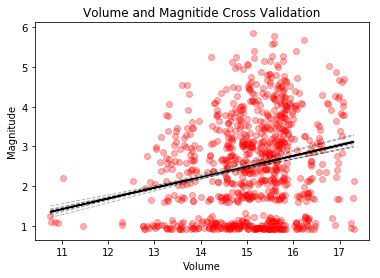

In [103]:
#k-fold cross validation. developed from INM430 Practical 07
from sklearn import cross_validation

numberOfSamples = len(arr1)

evaluatedLine = np.polyval([slope, intercept], volmag_log.Volume)
plt.scatter(volmag_log.Volume, volmag_log.magnitude, alpha=0.3, color = 'r')
plt.plot(volmag_log.Volume, evaluatedLine, 'k-')
    
kf = cross_validation.KFold(numberOfSamples, n_folds=10)
foldCount = 0
for train_index, test_index in kf:
    print("--RUN NUMBER: ", foldCount,"--")
    arraySubset1 = arr1[train_index]
    arraySubset2 = arr2[train_index]
    slope, intercept, r_value, p_value, std_err = stats.linregress(arraySubset1, arraySubset2)
    
    print("\n Slope: ", slope, "\n Intercept: ", intercept, "\n r_sq: ", r_value**2, "\n p_value: ", p_value,"\n std_err: ", std_err)
    print(" ")
    xp = np.linspace(arr1.min(), arr1.max(), 100)
    evaluatedLine = np.polyval([slope, intercept], xp)
    # Overlay line on graph for each run
    plt.plot(xp, evaluatedLine, 'k--', linewidth = 1, alpha = 0.3)
    plt.title("Volume and Magnitide Cross Validation")
    plt.xlabel("Volume")
    plt.ylabel("Magnitude")
    foldCount += 1 

The outputs of the runs were generally consistent each time, but showed signs of variability, ranging from 0.24 to 0.31. Furthermore, there was not much variability in the r-squared values, as these continued to perform poorly.

Model testing was then carried out. Here, unseen data points were inserted to the regression model, and the estimated values to the actaual values were compared to see how much they vary.

In [104]:
for train_index, test_index in kf:
    print("-------- We are having the run: ", foldCount )
    arraySubset1 = arr1[train_index]
    arraySubset2 = arr2[train_index]
    
    unseenSubset1 = arr1[test_index]
    unseenSubset2 = arr2[test_index]
    
    slope, intercept, r_value, p_value, std_err = stats.linregress(arraySubset1, arraySubset2)
    
    # Use the regression models to estimate the unseen "medIncome" values 
    # given their ViolentCrimesPerPop values.
    estimatedValues = slope * unseenSubset1 + intercept
    
    # check the differences between the estimates and the real values    
    differences = unseenSubset2 - estimatedValues
    print (np.average(differences))
    foldCount += 1 

-------- We are having the run:  10
-1.121311640109807
-------- We are having the run:  11
-0.7928086139048574
-------- We are having the run:  12
0.1599532434337079
-------- We are having the run:  13
0.3842040298741041
-------- We are having the run:  14
0.6257348488378713
-------- We are having the run:  15
0.5480523119797822
-------- We are having the run:  16
0.3894916813697857
-------- We are having the run:  17
0.20131698365338133
-------- We are having the run:  18
-0.08512393022694827
-------- We are having the run:  19
-0.28065202995412547


The model showed some variability again, with errors as high as as low as, -0.08, but as high as -1.12. Despit the variability, these were generally small with respect to the scale of the magnitude variable.

##### 3.3.3.2 UIC Pressure & Seismic Activity Regression

The same regression analysis process was carried out between the pressure and magniude variables.

In [105]:
# First do a Pearson correlation
corrPearson, pVal1 = stats.pearsonr(psimag_log.PSI, psimag_log.magnitude)
print("Correlation Pearson: ", corrPearson, pVal1)
# followed by a Spearman
corrSpearman, pVal2 = stats.spearmanr(psimag_log.PSI, psimag_log.magnitude)
print ("Correlation Spearman: ", corrSpearman, pVal2)

Correlation Pearson:  -0.22828209030347044 8.066277006754733e-12
Correlation Spearman:  -0.23449312812987555 2.0849550760911615e-12


This time, Spearman correlation appears to perform slighty better, likely because it is more suited to non-linear relationships. Linear regression using the statsmodels package was carried out, and the key values returned.

In [106]:
slope, intercept, r_value, p_value, std_err = stats.linregress(psimag_log.PSI, psimag_log.magnitude)
print ("Slope: ", slope)
print ("Intercept: ", intercept)
print ("p_value: ", p_value)
print ("std_err: ", std_err)
print ("Rsq: ", r_value**2)

Slope:  -0.3324793418301028
Intercept:  5.879367267731508
p_value:  8.066277006756166e-12
std_err:  0.04796400710044633
Rsq:  0.052112712753321806


It appears there is more of a negative correlation between fluid injection pressure and seismic activity. This could be expected, and may indicate that indicate UIC sites would be unlikely to inject fluid at high pressure for high volumes.  

However, again there was generally a poor r-squared result of 0.05 and high p-value. This again could indicate that UIC injection pressure, like volume, is not a good predictor of seismic activity.

In [107]:
line = slope*psimag_log.PSI+intercept

trace1 = Scatter(x = psimag_log.PSI,
                 y = psimag_log.magnitude,
                 mode='markers',
                 marker=dict(size=8, color = 'rgba(225, 225, 0, 0.3)')
                )

trace2 = Scatter(x=psimag_log.PSI,
                 y=line,
                 mode='lines',
                 marker=Marker(color='rgb(0, 0, 0)'),
                 name='Regression Line')

layout = Layout(title= 'Pressure & Magnitude Regression (2011-2017)',
                xaxis= dict(title= 'Pressure',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Magnitude',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1, trace2]

fig2222 = dict(data = data, layout = layout)
iplot(fig2222)

In [108]:
#define variables as separate arrays
arr3 = np.array(psimag_log.PSI)
arr4 = np.array(psimag_log.magnitude)

--RUN NUMBER:  0 --

 Slope:  -0.3098362363160667 
 Intercept:  5.7407436365563065 
 r_sq:  0.043322113595477316 
 p_value:  3.6749467344716587e-09 
 std_err:  0.051933666503843116
 
--RUN NUMBER:  1 --

 Slope:  -0.39886901899657995 
 Intercept:  6.6277156548911 
 r_sq:  0.07264152609277717 
 p_value:  1.396530552119156e-14 
 std_err:  0.0508335423457519
 
--RUN NUMBER:  2 --

 Slope:  -0.38944132485255234 
 Intercept:  6.416030331554498 
 r_sq:  0.06750224289086035 
 p_value:  1.2697227972889053e-13 
 std_err:  0.05162921921033838
 
--RUN NUMBER:  3 --

 Slope:  -0.3202827009121288 
 Intercept:  5.705243667704551 
 r_sq:  0.05073386632659986 
 p_value:  1.6038272465488084e-10 
 std_err:  0.04941595838629185
 
--RUN NUMBER:  4 --

 Slope:  -0.3087460578798535 
 Intercept:  5.568677884621468 
 r_sq:  0.047282307732158364 
 p_value:  6.90574939908405e-10 
 std_err:  0.0494336787186035
 
--RUN NUMBER:  5 --

 Slope:  -0.30273920026231466 
 Intercept:  5.532802516112737 
 r_sq:  0.0463149

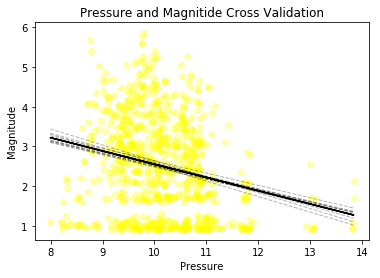

In [109]:
#k-fold cross validation. developed from INM430 Practical 07
from sklearn import cross_validation

numberOfSamples = len(arr3)

evaluatedLine = np.polyval([slope, intercept], psimag_log.PSI)
plt.scatter(psimag_log.PSI, psimag_log.magnitude, alpha=0.3, color = 'Yellow')
plt.plot(psimag_log.PSI, evaluatedLine, 'k-')
    
kf = cross_validation.KFold(numberOfSamples, n_folds=10)
foldCount = 0
for train_index, test_index in kf:
    print("--RUN NUMBER: ", foldCount,"--")
    arraySubset3 = arr3[train_index]
    arraySubset4 = arr4[train_index]
    slope, intercept, r_value, p_value, std_err = stats.linregress(arraySubset3, arraySubset4)
    
    print("\n Slope: ", slope, "\n Intercept: ", intercept, "\n r_sq: ", r_value**2, "\n p_value: ", p_value,"\n std_err: ", std_err)
    print(" ")
    xp = np.linspace(arr3.min(), arr3.max(), 100)
    evaluatedLine = np.polyval([slope, intercept], xp)
    # Overlay line on graph for each run
    plt.plot(xp, evaluatedLine, 'k--', linewidth = 1, alpha = 0.3)
    plt.title("Pressure and Magnitide Cross Validation")
    plt.xlabel("Pressure")
    plt.ylabel("Magnitude")
    foldCount += 1 

The outputs were generally consistent for each run, but showed signs of variability, ranging from -0.302 to -0.398. Furthermore, there was not much variability in the r-squared values, as these continued to perform poorly.

Model testing was then carried out.

In [110]:
for train_index, test_index in kf:
    print("-------- We are having the run: ", foldCount )
    arraySubset3 = arr3[train_index]
    arraySubset4 = arr4[train_index]
    
    unseenSubset3 = arr3[test_index]
    unseenSubset4 = arr4[test_index]
    
    slope, intercept, r_value, p_value, std_err = stats.linregress(arraySubset3, arraySubset4)
    
    # Use the regression models to estimate the unseen "medIncome" values 
    # given their ViolentCrimesPerPop values.
    estimatedValues = slope * unseenSubset3 + intercept
    
    # check the differences between the estimates and the real values    
    differences = unseenSubset4 - estimatedValues
    print (np.average(differences))
    foldCount += 1 

-------- We are having the run:  10
-0.9000224619076339
-------- We are having the run:  11
-0.7646228174682438
-------- We are having the run:  12
0.39332408733924606
-------- We are having the run:  13
0.5052289099481592
-------- We are having the run:  14
0.7030426932804432
-------- We are having the run:  15
0.4553289772315683
-------- We are having the run:  16
0.2727071125767262
-------- We are having the run:  17
0.047959842038964806
-------- We are having the run:  18
-0.2584846234968789
-------- We are having the run:  19
-0.4442826055136351


Model testing showed variability in predicting magnitude output. Although the errors were not very large relative to the predictor magnitude scale, the variability does indicate a non-robust model. It can be determined therefore that UIC injection pressure is not a string predictor of seimic activity alone.

##### 3.3.3.3. Multiple Regression

Multiple regression is used to when we want to predict the value of a variable based on the value of two or more variables. In this case, the dependant variable is the sum monthly magnitude per county, and the independent variables are total UIC injection volume for that month, and total UIC injection pressure for that month.

In [111]:
import statsmodels.api as sm
regressors = np.matrix([volmag.Volume, psimag.PSI])
regressors

matrix([[4.4137656e+06, 7.7474310e+06, 5.6513980e+06, ..., 3.8030995e+06,
         6.1958940e+06, 9.9429600e+05],
        [1.1723800e+05, 4.3076000e+04, 5.3630000e+04, ..., 3.8498000e+04,
         6.1920000e+03, 1.0194000e+04]])

The regressors were transposed so that there are equal numer of rows in each.

In [112]:
#transpose regressors, check shape
regressors_t = np.transpose(regressors)
print("Regressor shape: ",regressors_t.shape)

#define magnitude array, check shape
mag_arr = np.array(volmag.magnitude)
print("Magnitude (predictor) shape: ", mag_arr.shape)

Regressor shape:  (876, 2)
Magnitude (predictor) shape:  (876,)


In [113]:
import statsmodels.api as sm
r_squ= []

numberOfSamples = len(mag_arr)

kf = cross_validation.KFold(numberOfSamples, n_folds=5)
foldCount = 0
for train_index, test_index in kf:
    
    print("--RUN NUMBER: ", foldCount,"--")
    arraySubset5 = mag_arr[train_index]
    arraySubset6 = regressors_t[train_index]
    
    regressors_t = sm.add_constant(regressors_t)
    
    model_m = sm.OLS(arraySubset5, arraySubset6, hasconst=False)
    results_m = model_m.fit()
    
    print("RUN SUMMARY: ", results_m.summary())
    r_squ.append(results_m.rsquared)
    foldCount += 1

average_rsq = np.array(r_squ).mean()
print("Average R squared: ", average_rsq)

--RUN NUMBER:  0 --
RUN SUMMARY:                              OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.260
Model:                            OLS   Adj. R-squared:                  0.258
Method:                 Least Squares   F-statistic:                     122.9
Date:                Sun, 16 Dec 2018   Prob (F-statistic):           1.92e-46
Time:                        17:25:46   Log-Likelihood:                -3652.6
No. Observations:                 700   AIC:                             7309.
Df Residuals:                     698   BIC:                             7318.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1          4.021e

The cross-validation of the multiple regression model using 5 folds shows that there is an average R-squared score of 0.315.

The output from the multiple regression shows that a regression model using both UIC injection pressure and UIC injection volume does not provide a more robust predictor of seismic activity in Oklahoma than simply using single linear regression models using UIC Injection volume and UIC injection pressure alone.

### 3.4. Social Attititudes to Fracking

Twitter provides a rich information source for social sciences. Everyday, millions of tweets are posted by people giving opinions on a plethora of topics. Since fracking has become more of a common practice since in the 21st century, there have been a wide range of opinions about it. In the USA, there has been wide criticism about the practice over the last decade. In the UK, anti-fracking protest groups have been on the rise against the practice. 

The final research question in this project aims to see whether attitudes towards fracking can be analysed using data mined from Twitter.

#### 3.4.1. Tweet Retrieval

Tweets were retrived using the Twitter API.

Firstly, some important additional dependancies were imported.

In [114]:
#import dependancies
import tweepy
from textblob import TextBlob
import csv

#set working directory#
os.chdir(r'C:\Users\aczd067\OD\INM430-PriciplesOfDataScience\Fracking\Data\Twitter')

The Twitter Developer API credentials were defined below.

In [115]:
####input your credentials here
consumer_key = 'xBu0XgP3EM2NmQP5UcBNVnuTs'
consumer_secret = 'E4ebWcpnbfV5RRJA0KgJd09MJBlV8rdcyTrQJBkoAfJ7BvWK8L'
access_token = '1069582682517135360-wjroF2DkLqvadKvJ4jFFS7Iclb9PtF'
access_token_secret = '0ddS9LVeGNCmtPz7bGbBsFzMN3zDLlHbAgKhiwWEcBDOI'

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_token_secret)
api = tweepy.API(auth,wait_on_rate_limit=True)

The script below scrapes twitter data for tweets containing a sepecific string. In this case, we will find all tweets in the last week related to fracking, by retrieving all tweets with the hashtag '#fracking'.

During this process, a useful library, 'TextBlob' is used to score the sentiment for each tweet. Namely, 'Polarity' (How positive or negative the sentiment is) and 'Subjectivity' (how opinionated or factual the tweet is).

*To eliminate overwriting of the dataset, the code to do this has been commented out.

In [116]:
        # Open/Create a file to append data
#csvFile = open("tweets_final.csv", 'a')
        #Use csv Writer
#csvWriter = csv.writer(csvFile)

#for tweet in tweepy.Cursor(api.search,q="#fracking",count=1000,
#                           lang="en",
#                           since="2017-04-03").items():
#    analysis = TextBlob(tweet.text)
#    print (tweet.created_at, tweet.text, analysis.sentiment.polarity, analysis.sentiment.subjectivity)
#    csvWriter.writerow([tweet.created_at, tweet.text.encode('utf-8'), analysis.sentiment.polarity, analysis.sentiment.subjectivity])

In [117]:
frack_tweets = pd.read_csv('tweets_final.csv', names = ['date', 'tweet', 'sentiment_polarity', 'sentiment_subjectivity'])

In [118]:
frack_tweets.head()

,date,tweet,sentiment_polarity,sentiment_subjectivity
0,2018-12-12 17:53:12,b'RT @triodosuk: Fracking has hit the news onc...,0.0,0.10
1,2018-12-12 17:51:43,b'RT @TXsharon: Skull and crossbones warning p...,-0.2,0.40
2,2018-12-12 17:51:40,"b'RT @natalieben: \xc3\x9doung campaigners, in...",0.0,0.00
3,2018-12-12 17:51:33,"b'RT @kali0x2a: ""US House Opposes Russian Gas ...",0.1,0.10
4,2018-12-12 17:51:30,b'Yet more #fracking obfuscation from Cuadrill...,0.2,0.35


In [119]:
frack_tweets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8863 entries, 0 to 8862
Data columns (total 4 columns):
date                      8863 non-null object
tweet                     8863 non-null object
sentiment_polarity        8863 non-null float64
sentiment_subjectivity    8863 non-null float64
dtypes: float64(2), object(2)
memory usage: 277.0+ KB


We can see that 8,862 tweets were retrived from the search for a one-week period. All these tweets have information on the date, the tweet and the polarity/subjectivity score.

#### 3.4.2. Tweet Preprocessing

Lot's of the tweets show both 0 subjectivity and 0 polarity. These indicate that the algorithm couldnt assign a good score to them. These were dropped from the analysis.

In [120]:
tweets = frack_tweets[(frack_tweets['sentiment_polarity'] != 0 ) & (frack_tweets['sentiment_subjectivity'] != 0)]
len(tweets)

5660

The removal of these tweets meant that 5,660 tweets containing the hashtag '#fracking' remained for analysis.

#### 3.4.3. Sentiment Analysis and Evaluation

The number of positive and negative tweetd can be seen below.

In [121]:
print("Number of positive tweets: ",len(tweets[tweets['sentiment_polarity']>0]))
print("Number of negative tweets: ",len(tweets[tweets['sentiment_polarity']<0]))

Number of positive tweets:  4447
Number of negative tweets:  1213


In [122]:
data = [Bar(x=['Negative', 'Positive'],
            y=[len(tweets[tweets['sentiment_polarity']<0]), len(tweets[tweets['sentiment_polarity']>0])],
            marker=dict(color=['rgba(222,45,38,0.6)', 'rgba(0,128,0,0.6)'])
           )]

layout = Layout(title='Fracking Tweet Sentiment',
               )

fig991 = dict(data = data, layout = layout)
iplot(fig991)

Interestingly, it appears that the majority of tweets are positive towards fracking, with only 1,213 of 5,660 tweets negative towards fracking. 

The individual tweets were visualised on the plot below for further analysis.

In [123]:
trace1 = Scatter(x = tweets.sentiment_polarity,
                 y = tweets.sentiment_subjectivity,
                 mode='markers',
                 marker=dict(size=8,
                             color = tweets.sentiment_polarity, #set color equal to a variable
                             colorscale=[[0.0, 'rgba(255, 0, 0, 0.3)'],  
                                         [0.5, 'rgba(214, 214, 214, 0.3)'],
                                         [1.0, 'rgba(0,128,0, 0.3)']],
                             showscale=True),
                 text = tweets['tweet']
                )
layout = Layout(title= 'Tweet Polarity & Subjectivity',
                hovermode= 'closest',
                xaxis= dict(title= 'Tweet Polarity',ticklen= 0.5, zeroline= True, gridwidth= 0.5),
                yaxis=dict(title= 'Tweet Subjectivity',ticklen= 0.5, gridwidth= 0.5))
                
data = [trace1]

fig92 = dict(data = data, layout = layout)
iplot(fig92)

Here we can take a closer look at tweet sentiment and subjectivity. Again thr graph illustrates that more tweets are positive about fracking. Interestingly, the as tweets become more subjective and opinionated, they become more polarised. Meaning that people tend to have strong opinions about fracking.

By hovering over each of tweets allows the tweet to be viewed. Further inspection shows that the results may not be reliable. For instance, the most positive tweet in the top right of the plot is quite obviously negative about fracking, but the obvious sarcasm is not picked up by the TextBlob algorithm.

These instances are evident numerous times acriss the plot. It may be valid to say that sentiment analysis using TextBlob is not a robust method for measuring public opinion about fracking.